**Context**: In this TP, we will use MedMNIST, a large-scale MNIST-like collection of standardized biomedical images, including 12 datasets for 2D and 6 datasets for 3D. All images are pre-processed into different sizes: 28x28, 64x64, 128x128 and 256x256 with the corresponding classification labels. The size of the datasets varies from 100 to 100,000 images with different tasks, in particular: binary/multi-class.

**Goal**: Implement and use at **two**  explainability methods seen during the lecture of today (e.g., Attribution, CAM, LIME) on at least **two** different networks and **two** MedMNIST datasets (e.g., PathMNISt and DermaMNIST). You can use the image size you want (the bigger, the easier to interpret but the more computational capability you will need, please choose according to your computational capability).

**Implementation**: for complex methods ([SHAP](https://shap.readthedocs.io/en/latest/), [LRP](https://github.com/sebastian-lapuschkin/lrp_toolbox), [Integrated Gradients](https://captum.ai/docs/introduction), DeepLIFT) you can use existign implementations. See also: https://github.com/interpretml/interpret, https://github.com/marcoancona/DeepExplain,

**Deadline**: Please check on the course website.

In [1]:
import os
import torch
import numpy as np

In [2]:
# In this notebook, we use data loaders with heavier computational processing. It is recommended to use as many
# workers as possible in a data loader, which corresponds to the number of CPU cores
NUM_WORKERS = os.cpu_count()
print("Number of workers:", NUM_WORKERS)

# Ensure that all operations are deterministic on GPU (if used) for reproducibility
torch.backends.cudnn.determinstic = True
torch.backends.cudnn.benchmark = False

# For reproducibility
np.random.seed(666)
torch.manual_seed(666)


try:
  import google.colab
  IN_COLAB = True
  !pip install medmnist
except:
  IN_COLAB = False

Number of workers: 2


In [3]:
from tqdm import tqdm
import torch.nn as nn
import torch.optim as optim
import torch.utils.data as data
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
from torchvision.models import resnet18, resnet50
from tqdm import trange

import medmnist
from medmnist import INFO, Evaluator

import matplotlib.pyplot as plt
from PIL import Image
from skimage.segmentation import quickshift

print(f"MedMNIST v{medmnist.__version__} @ {medmnist.HOMEPAGE}")

MedMNIST v3.0.2 @ https://github.com/MedMNIST/MedMNIST/


In [4]:
print("Using torch", torch.__version__)

if torch.backends.mps.is_available():
    device = torch.device("mps")
    print ("MPS device found.")
elif torch.cuda.is_available():
    device = torch.device("cuda:0") # we use one GPU, the first one
    print ("CUDA device found.")
else:
   device = torch.device("cpu")
   print('No MPS or CUDA has been found. PyTorch will use CPU.')

Using torch 2.5.1+cu124
CUDA device found.


Here you can choose which dataset you want to use and the image size. Please use 28x28 at the beginning. Change the batch size according to your computational capability (1024 is good for Google Colab)

In [5]:
# Dataset Hyper-parameters
dataset_name = "pneumoniamnist"  # Change this to any MedMNIST dataset (e.g., "chestmnist", "bloodmnist")
SIZE_IMAGES = 28 # 28, 64, 128, 256
BATCH_SIZE = 1024

Here we download the data and create the datasets and loaders.

In [6]:
# Function to load any MedMNIST dataset
def load_medmnist(dataset_name, BATCH_SIZE, SIZE_IMAGES):
    info = INFO[dataset_name]
    num_classes = len(info["label"])
    in_channels = 3 if info["n_channels"] == 3 else 1  # Handle grayscale & RGB

    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5] * in_channels, std=[0.5] * in_channels)
    ])

    DataClass = getattr(medmnist, info["python_class"])

    train_dataset = DataClass(split="train", transform=transform, download=True, size=SIZE_IMAGES)
    val_dataset = DataClass(split="val", transform=transform, download=True, size=SIZE_IMAGES)
    test_dataset = DataClass(split="test", transform=transform, download=True, size=SIZE_IMAGES)

    train_loader = DataLoader(dataset=train_dataset, batch_size=BATCH_SIZE, shuffle=True)
    val_loader = DataLoader(dataset=val_dataset, batch_size=BATCH_SIZE, shuffle=False)
    test_loader = DataLoader(dataset=test_dataset, batch_size=BATCH_SIZE, shuffle=False)

    task=info['task']

    return train_dataset, val_dataset, test_dataset,  train_loader, val_loader, test_loader, in_channels, num_classes, task

Here you can check the task, the number of data and verify the image size.

In [ ]:
# Run training on any MedMNIST dataset
train_dataset, val_dataset, test_dataset, train_loader, val_loader, test_loader, in_channels, num_classes, task = load_medmnist(dataset_name, BATCH_SIZE, SIZE_IMAGES)

print('The task is', task)
# Get image size from the dataset
image_size = train_loader.dataset.imgs.shape[1]  # Works for all MedMNIST datasets
print('The size of images is ', image_size)

Using downloaded and verified file: /root/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /root/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /root/.medmnist/pneumoniamnist.npz
The task is binary-class
The size of images is  28


In [ ]:
print(train_dataset)
print("===================")
print(val_dataset)
print("===================")
print(test_dataset)

Dataset PneumoniaMNIST of size 28 (pneumoniamnist)
    Number of datapoints: 4708
    Root location: /root/.medmnist
    Split: train
    Task: binary-class
    Number of channels: 1
    Meaning of labels: {'0': 'normal', '1': 'pneumonia'}
    Number of samples: {'train': 4708, 'val': 524, 'test': 624}
    Description: The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384−2,916)×(127−2,713). We center-crop the images and resize them into 1×28×28.
    License: CC BY 4.0
Dataset PneumoniaMNIST of size 28 (pneumoniamnist)
    Number of datapoints: 524
    Root location: /root/.medmnist
    Split: val
    Task: binary-class
    Number of channels: 1
    Meaning of labels: {'0': 'normal', '1': 'pneu

The authors of MedMNIST has created a function to plot the images.

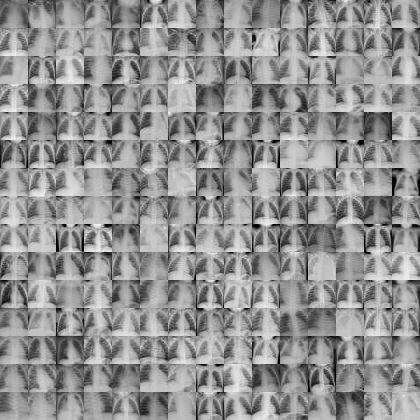

In [ ]:
# montage
train_dataset.montage(length=15)

Please change the Number of epochs to 1 or 2 to test the code.

In [ ]:
# Optimization Hyper-parameters
NUM_EPOCHS = 150
lr = 0.001

At first, we will use a very simple network proposed by the authors of MedMNIST. Look at it carefully. You will change it later on.

In [7]:
# define a simple CNN model (from MedMNIST website)
class Net(nn.Module):
    def __init__(self, in_channels, num_classes):
        super(Net, self).__init__()

        self.layer1 = nn.Sequential(
            nn.Conv2d(in_channels, 16, kernel_size=3),
            nn.BatchNorm2d(16),
            nn.ReLU())

        self.layer2 = nn.Sequential(
            nn.Conv2d(16, 16, kernel_size=3),
            nn.BatchNorm2d(16),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2))

        self.layer3 = nn.Sequential(
            nn.Conv2d(16, 64, kernel_size=3),
            nn.BatchNorm2d(64),
            nn.ReLU())

        self.layer4 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3),
            nn.BatchNorm2d(64),
            nn.ReLU())

        self.layer5 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2))

        self.fc = nn.Sequential(
            nn.Linear(64 * 4 * 4, 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, num_classes))

    def forward(self, x):
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        x = self.layer5(x)
        x = x.view(x.size(0), -1)
        #print(x.shape)
        x = self.fc(x)
        return x


We can initalize the model and train it.

In [ ]:
# Initialize model
model = Net(in_channels=in_channels, num_classes=num_classes)

**Question**: Look at the training and validation code. Why do we separate for binary and multi class ?

We separate binary and multi-class classification because the loss is not the same. Moreover, for multi-class, we use one-hot-encodings instead of just 0/1 for binary classification.

In [8]:
# Training Function
def train_model(model, train_loader, val_loader, task, num_epochs, lr):
    model.to(device)

    # Choose loss function based on the task type
    if task == "multi-label, binary-class":
        criterion = nn.BCEWithLogitsLoss().to(device)
    else: # multi-class
        criterion = nn.CrossEntropyLoss().to(device)

    optimizer = optim.SGD(model.parameters(), lr=lr, momentum=0.9)

    train_loss_list = []
    train_acc_list = []
    val_loss_list = []
    val_acc_list = []
    # Training loop
    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0

        for images, labels in tqdm(train_loader):
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(images)

            if task == "multi-label, binary-class":
              labels = labels.to(torch.float32)  # Ensure float for BCEWithLogitsLoss
            else: # multi-class
              labels = labels.squeeze().long() # Convert one-hot to class index

            loss = criterion(outputs, labels)

            loss.backward()
            optimizer.step()

            running_loss += loss.item()

            # Compute Accuracy for CrossEntropyLoss or BCEWithLogitsLoss
            if task == "multi-label, binary-class":  # Binary classification
                outputs = torch.sigmoid(outputs)  # Apply sigmoid for binary classification
                predicted = (outputs >= 0.5).long()  # Threshold at 0.5 for binary classification
            else:  # Multi-class classification
                _, predicted = torch.max(outputs, 1)  # Get predicted class index

            correct += (predicted == labels).sum().item()
            total += labels.size(0)

        train_loss_list.append(running_loss/len(train_loader))
        accuracy = 100 * correct / total
        train_acc_list.append(accuracy)
        print(f"Epoch {epoch+1}/{num_epochs}, Loss: {running_loss/len(train_loader):.4f}, Accuracy: {accuracy:.2f}%")


        # Validation phase
        model.eval()  # Set model to evaluation mode (disables dropout, batchnorm, etc.)
        val_loss = 0.0
        val_correct = 0
        val_total = 0

        with torch.no_grad():  # No need to compute gradients for validation
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)

                if task == "multi-label, binary-class":
                  labels = labels.to(torch.float32)  # Ensure float for BCEWithLogitsLoss
                else:
                  labels = labels.squeeze().long() # Convert one-hot to class index

                loss = criterion(outputs, labels)

                val_loss += loss.item()

                # Compute Accuracy for CrossEntropyLoss or BCEWithLogitsLoss
                if task == "multi-label, binary-class":  # Binary classification
                    outputs = torch.sigmoid(outputs)  # Apply sigmoid for binary classification
                    predicted = (outputs >= 0.5).long()  # Threshold at 0.5 for binary classification
                else:  # Multi-class classification
                    _, predicted = torch.max(outputs, 1)

                val_correct += (predicted == labels).sum().item()
                val_total += labels.size(0)

        # Compute validation accuracy
        val_loss_list.append(val_loss/len(val_loader))
        val_accuracy = 100 * val_correct / val_total
        val_acc_list.append(val_accuracy)
        print(f"Epoch {epoch+1}/{num_epochs}, Val Loss: {val_loss/len(test_loader):.4f}, Val Accuracy: {val_accuracy:.2f}%")

    plt.figure()
    plt.plot(train_loss_list, label='Training Loss')
    plt.plot(val_loss_list, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

    plt.figure()
    plt.plot(train_acc_list, label='Training Accuracy')
    plt.plot(val_acc_list, label='Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.show()

    return model


You can now train your model.

100%|██████████| 5/5 [00:01<00:00,  4.68it/s]


Epoch 1/150, Loss: 0.6957, Accuracy: 44.56%
Epoch 1/150, Val Loss: 0.7149, Val Accuracy: 25.76%


100%|██████████| 5/5 [00:01<00:00,  4.42it/s]


Epoch 2/150, Loss: 0.6603, Accuracy: 72.98%
Epoch 2/150, Val Loss: 0.7007, Val Accuracy: 25.76%


100%|██████████| 5/5 [00:01<00:00,  4.73it/s]


Epoch 3/150, Loss: 0.6104, Accuracy: 74.21%
Epoch 3/150, Val Loss: 0.6764, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:01<00:00,  4.76it/s]


Epoch 4/150, Loss: 0.5607, Accuracy: 74.21%
Epoch 4/150, Val Loss: 0.6402, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:01<00:00,  4.82it/s]


Epoch 5/150, Loss: 0.5142, Accuracy: 74.21%
Epoch 5/150, Val Loss: 0.5966, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:01<00:00,  4.06it/s]


Epoch 6/150, Loss: 0.4725, Accuracy: 74.41%
Epoch 6/150, Val Loss: 0.5529, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:01<00:00,  3.40it/s]


Epoch 7/150, Loss: 0.4265, Accuracy: 76.72%
Epoch 7/150, Val Loss: 0.5105, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:01<00:00,  4.01it/s]


Epoch 8/150, Loss: 0.3858, Accuracy: 81.80%
Epoch 8/150, Val Loss: 0.4620, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:01<00:00,  4.95it/s]


Epoch 9/150, Loss: 0.3519, Accuracy: 86.43%
Epoch 9/150, Val Loss: 0.4091, Val Accuracy: 76.34%


100%|██████████| 5/5 [00:01<00:00,  4.82it/s]


Epoch 10/150, Loss: 0.3181, Accuracy: 88.89%
Epoch 10/150, Val Loss: 0.3600, Val Accuracy: 79.77%


100%|██████████| 5/5 [00:01<00:00,  4.77it/s]


Epoch 11/150, Loss: 0.2910, Accuracy: 90.70%
Epoch 11/150, Val Loss: 0.3185, Val Accuracy: 85.31%


100%|██████████| 5/5 [00:01<00:00,  4.83it/s]


Epoch 12/150, Loss: 0.2673, Accuracy: 91.69%
Epoch 12/150, Val Loss: 0.2850, Val Accuracy: 88.36%


100%|██████████| 5/5 [00:01<00:00,  4.75it/s]


Epoch 13/150, Loss: 0.2465, Accuracy: 92.50%
Epoch 13/150, Val Loss: 0.2570, Val Accuracy: 89.50%


100%|██████████| 5/5 [00:01<00:00,  4.76it/s]


Epoch 14/150, Loss: 0.2295, Accuracy: 93.31%
Epoch 14/150, Val Loss: 0.2356, Val Accuracy: 91.03%


100%|██████████| 5/5 [00:01<00:00,  4.88it/s]


Epoch 15/150, Loss: 0.2148, Accuracy: 93.37%
Epoch 15/150, Val Loss: 0.2194, Val Accuracy: 92.37%


100%|██████████| 5/5 [00:01<00:00,  4.08it/s]


Epoch 16/150, Loss: 0.2008, Accuracy: 93.56%
Epoch 16/150, Val Loss: 0.2041, Val Accuracy: 92.75%


100%|██████████| 5/5 [00:01<00:00,  3.32it/s]


Epoch 17/150, Loss: 0.1903, Accuracy: 93.59%
Epoch 17/150, Val Loss: 0.1936, Val Accuracy: 92.75%


100%|██████████| 5/5 [00:01<00:00,  4.74it/s]


Epoch 18/150, Loss: 0.1805, Accuracy: 93.78%
Epoch 18/150, Val Loss: 0.1847, Val Accuracy: 92.75%


100%|██████████| 5/5 [00:01<00:00,  4.83it/s]


Epoch 19/150, Loss: 0.1709, Accuracy: 93.88%
Epoch 19/150, Val Loss: 0.1752, Val Accuracy: 93.70%


100%|██████████| 5/5 [00:01<00:00,  4.76it/s]


Epoch 20/150, Loss: 0.1634, Accuracy: 93.95%
Epoch 20/150, Val Loss: 0.1673, Val Accuracy: 93.70%


100%|██████████| 5/5 [00:01<00:00,  4.73it/s]


Epoch 21/150, Loss: 0.1581, Accuracy: 94.18%
Epoch 21/150, Val Loss: 0.1616, Val Accuracy: 94.08%


100%|██████████| 5/5 [00:01<00:00,  4.81it/s]


Epoch 22/150, Loss: 0.1528, Accuracy: 94.24%
Epoch 22/150, Val Loss: 0.1570, Val Accuracy: 94.27%


100%|██████████| 5/5 [00:01<00:00,  4.64it/s]


Epoch 23/150, Loss: 0.1475, Accuracy: 94.33%
Epoch 23/150, Val Loss: 0.1513, Val Accuracy: 94.47%


100%|██████████| 5/5 [00:01<00:00,  4.68it/s]


Epoch 24/150, Loss: 0.1421, Accuracy: 94.54%
Epoch 24/150, Val Loss: 0.1452, Val Accuracy: 94.85%


100%|██████████| 5/5 [00:01<00:00,  4.78it/s]


Epoch 25/150, Loss: 0.1373, Accuracy: 94.88%
Epoch 25/150, Val Loss: 0.1432, Val Accuracy: 94.47%


100%|██████████| 5/5 [00:01<00:00,  4.10it/s]


Epoch 26/150, Loss: 0.1345, Accuracy: 94.94%
Epoch 26/150, Val Loss: 0.1387, Val Accuracy: 94.66%


100%|██████████| 5/5 [00:01<00:00,  3.40it/s]


Epoch 27/150, Loss: 0.1312, Accuracy: 94.90%
Epoch 27/150, Val Loss: 0.1337, Val Accuracy: 95.04%


100%|██████████| 5/5 [00:01<00:00,  4.80it/s]


Epoch 28/150, Loss: 0.1292, Accuracy: 95.11%
Epoch 28/150, Val Loss: 0.1304, Val Accuracy: 95.42%


100%|██████████| 5/5 [00:01<00:00,  4.78it/s]


Epoch 29/150, Loss: 0.1269, Accuracy: 95.39%
Epoch 29/150, Val Loss: 0.1275, Val Accuracy: 95.61%


100%|██████████| 5/5 [00:01<00:00,  4.75it/s]


Epoch 30/150, Loss: 0.1227, Accuracy: 95.31%
Epoch 30/150, Val Loss: 0.1254, Val Accuracy: 95.61%


100%|██████████| 5/5 [00:01<00:00,  4.86it/s]


Epoch 31/150, Loss: 0.1199, Accuracy: 95.41%
Epoch 31/150, Val Loss: 0.1211, Val Accuracy: 95.80%


100%|██████████| 5/5 [00:01<00:00,  4.81it/s]


Epoch 32/150, Loss: 0.1181, Accuracy: 95.67%
Epoch 32/150, Val Loss: 0.1182, Val Accuracy: 96.18%


100%|██████████| 5/5 [00:01<00:00,  4.91it/s]


Epoch 33/150, Loss: 0.1133, Accuracy: 95.58%
Epoch 33/150, Val Loss: 0.1171, Val Accuracy: 95.99%


100%|██████████| 5/5 [00:01<00:00,  4.77it/s]


Epoch 34/150, Loss: 0.1128, Accuracy: 95.71%
Epoch 34/150, Val Loss: 0.1134, Val Accuracy: 96.56%


100%|██████████| 5/5 [00:01<00:00,  4.81it/s]


Epoch 35/150, Loss: 0.1121, Accuracy: 95.84%
Epoch 35/150, Val Loss: 0.1112, Val Accuracy: 96.37%


100%|██████████| 5/5 [00:01<00:00,  4.23it/s]


Epoch 36/150, Loss: 0.1094, Accuracy: 95.94%
Epoch 36/150, Val Loss: 0.1095, Val Accuracy: 96.56%


100%|██████████| 5/5 [00:01<00:00,  3.61it/s]


Epoch 37/150, Loss: 0.1055, Accuracy: 96.07%
Epoch 37/150, Val Loss: 0.1064, Val Accuracy: 96.56%


100%|██████████| 5/5 [00:01<00:00,  4.73it/s]


Epoch 38/150, Loss: 0.1055, Accuracy: 96.05%
Epoch 38/150, Val Loss: 0.1060, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:01<00:00,  4.65it/s]


Epoch 39/150, Loss: 0.1036, Accuracy: 96.13%
Epoch 39/150, Val Loss: 0.1035, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:01<00:00,  4.62it/s]


Epoch 40/150, Loss: 0.1000, Accuracy: 96.28%
Epoch 40/150, Val Loss: 0.1024, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:01<00:00,  3.98it/s]


Epoch 41/150, Loss: 0.0986, Accuracy: 96.39%
Epoch 41/150, Val Loss: 0.0991, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:01<00:00,  4.58it/s]


Epoch 42/150, Loss: 0.0972, Accuracy: 96.62%
Epoch 42/150, Val Loss: 0.1016, Val Accuracy: 96.56%


100%|██████████| 5/5 [00:01<00:00,  4.69it/s]


Epoch 43/150, Loss: 0.0956, Accuracy: 96.52%
Epoch 43/150, Val Loss: 0.0961, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:01<00:00,  4.76it/s]


Epoch 44/150, Loss: 0.0924, Accuracy: 96.58%
Epoch 44/150, Val Loss: 0.0940, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:01<00:00,  4.84it/s]


Epoch 45/150, Loss: 0.0926, Accuracy: 96.67%
Epoch 45/150, Val Loss: 0.0966, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:01<00:00,  3.98it/s]


Epoch 46/150, Loss: 0.0921, Accuracy: 96.75%
Epoch 46/150, Val Loss: 0.0926, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:01<00:00,  3.56it/s]


Epoch 47/150, Loss: 0.0904, Accuracy: 96.77%
Epoch 47/150, Val Loss: 0.0904, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:01<00:00,  4.89it/s]


Epoch 48/150, Loss: 0.0884, Accuracy: 96.81%
Epoch 48/150, Val Loss: 0.0904, Val Accuracy: 97.33%


100%|██████████| 5/5 [00:01<00:00,  4.78it/s]


Epoch 49/150, Loss: 0.0858, Accuracy: 96.96%
Epoch 49/150, Val Loss: 0.0885, Val Accuracy: 97.14%


100%|██████████| 5/5 [00:01<00:00,  4.87it/s]


Epoch 50/150, Loss: 0.0857, Accuracy: 96.92%
Epoch 50/150, Val Loss: 0.0868, Val Accuracy: 97.33%


100%|██████████| 5/5 [00:01<00:00,  4.84it/s]


Epoch 51/150, Loss: 0.0835, Accuracy: 97.01%
Epoch 51/150, Val Loss: 0.0870, Val Accuracy: 97.52%


100%|██████████| 5/5 [00:01<00:00,  4.79it/s]


Epoch 52/150, Loss: 0.0821, Accuracy: 97.13%
Epoch 52/150, Val Loss: 0.0846, Val Accuracy: 97.52%


100%|██████████| 5/5 [00:01<00:00,  4.76it/s]


Epoch 53/150, Loss: 0.0802, Accuracy: 97.13%
Epoch 53/150, Val Loss: 0.0834, Val Accuracy: 97.33%


100%|██████████| 5/5 [00:01<00:00,  4.85it/s]


Epoch 54/150, Loss: 0.0796, Accuracy: 97.32%
Epoch 54/150, Val Loss: 0.0824, Val Accuracy: 97.71%


100%|██████████| 5/5 [00:01<00:00,  4.81it/s]


Epoch 55/150, Loss: 0.0791, Accuracy: 97.26%
Epoch 55/150, Val Loss: 0.0815, Val Accuracy: 97.52%


100%|██████████| 5/5 [00:01<00:00,  4.26it/s]


Epoch 56/150, Loss: 0.0761, Accuracy: 97.41%
Epoch 56/150, Val Loss: 0.0805, Val Accuracy: 97.71%


100%|██████████| 5/5 [00:01<00:00,  3.51it/s]


Epoch 57/150, Loss: 0.0759, Accuracy: 97.39%
Epoch 57/150, Val Loss: 0.0817, Val Accuracy: 97.90%


100%|██████████| 5/5 [00:01<00:00,  4.85it/s]


Epoch 58/150, Loss: 0.0744, Accuracy: 97.47%
Epoch 58/150, Val Loss: 0.0789, Val Accuracy: 97.71%


100%|██████████| 5/5 [00:01<00:00,  4.75it/s]


Epoch 59/150, Loss: 0.0749, Accuracy: 97.45%
Epoch 59/150, Val Loss: 0.0784, Val Accuracy: 97.71%


100%|██████████| 5/5 [00:01<00:00,  4.82it/s]


Epoch 60/150, Loss: 0.0715, Accuracy: 97.56%
Epoch 60/150, Val Loss: 0.0783, Val Accuracy: 97.90%


100%|██████████| 5/5 [00:01<00:00,  4.86it/s]


Epoch 61/150, Loss: 0.0705, Accuracy: 97.58%
Epoch 61/150, Val Loss: 0.0759, Val Accuracy: 97.90%


100%|██████████| 5/5 [00:01<00:00,  3.88it/s]


Epoch 62/150, Loss: 0.0692, Accuracy: 97.51%
Epoch 62/150, Val Loss: 0.0754, Val Accuracy: 97.90%


100%|██████████| 5/5 [00:01<00:00,  4.56it/s]


Epoch 63/150, Loss: 0.0691, Accuracy: 97.64%
Epoch 63/150, Val Loss: 0.0750, Val Accuracy: 97.90%


100%|██████████| 5/5 [00:01<00:00,  4.81it/s]


Epoch 64/150, Loss: 0.0698, Accuracy: 97.66%
Epoch 64/150, Val Loss: 0.0740, Val Accuracy: 98.09%


100%|██████████| 5/5 [00:01<00:00,  5.00it/s]


Epoch 65/150, Loss: 0.0661, Accuracy: 97.79%
Epoch 65/150, Val Loss: 0.0731, Val Accuracy: 97.90%


100%|██████████| 5/5 [00:01<00:00,  3.93it/s]


Epoch 66/150, Loss: 0.0659, Accuracy: 97.92%
Epoch 66/150, Val Loss: 0.0734, Val Accuracy: 97.90%


100%|██████████| 5/5 [00:01<00:00,  3.66it/s]


Epoch 67/150, Loss: 0.0650, Accuracy: 97.75%
Epoch 67/150, Val Loss: 0.0718, Val Accuracy: 97.90%


100%|██████████| 5/5 [00:01<00:00,  4.91it/s]


Epoch 68/150, Loss: 0.0641, Accuracy: 97.96%
Epoch 68/150, Val Loss: 0.0718, Val Accuracy: 98.28%


100%|██████████| 5/5 [00:01<00:00,  4.77it/s]


Epoch 69/150, Loss: 0.0640, Accuracy: 98.07%
Epoch 69/150, Val Loss: 0.0728, Val Accuracy: 97.90%


100%|██████████| 5/5 [00:01<00:00,  4.86it/s]


Epoch 70/150, Loss: 0.0630, Accuracy: 98.02%
Epoch 70/150, Val Loss: 0.0698, Val Accuracy: 98.28%


100%|██████████| 5/5 [00:01<00:00,  4.98it/s]


Epoch 71/150, Loss: 0.0606, Accuracy: 98.09%
Epoch 71/150, Val Loss: 0.0693, Val Accuracy: 98.28%


100%|██████████| 5/5 [00:01<00:00,  4.77it/s]


Epoch 72/150, Loss: 0.0621, Accuracy: 98.13%
Epoch 72/150, Val Loss: 0.0718, Val Accuracy: 97.90%


100%|██████████| 5/5 [00:01<00:00,  4.17it/s]


Epoch 73/150, Loss: 0.0599, Accuracy: 98.11%
Epoch 73/150, Val Loss: 0.0685, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.91it/s]


Epoch 74/150, Loss: 0.0584, Accuracy: 98.19%
Epoch 74/150, Val Loss: 0.0679, Val Accuracy: 98.28%


100%|██████████| 5/5 [00:01<00:00,  4.83it/s]


Epoch 75/150, Loss: 0.0585, Accuracy: 98.19%
Epoch 75/150, Val Loss: 0.0703, Val Accuracy: 97.90%


100%|██████████| 5/5 [00:01<00:00,  4.05it/s]


Epoch 76/150, Loss: 0.0563, Accuracy: 98.15%
Epoch 76/150, Val Loss: 0.0673, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  3.63it/s]


Epoch 77/150, Loss: 0.0550, Accuracy: 98.26%
Epoch 77/150, Val Loss: 0.0669, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.84it/s]


Epoch 78/150, Loss: 0.0552, Accuracy: 98.32%
Epoch 78/150, Val Loss: 0.0669, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.79it/s]


Epoch 79/150, Loss: 0.0544, Accuracy: 98.36%
Epoch 79/150, Val Loss: 0.0668, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.78it/s]


Epoch 80/150, Loss: 0.0537, Accuracy: 98.41%
Epoch 80/150, Val Loss: 0.0666, Val Accuracy: 98.09%


100%|██████████| 5/5 [00:01<00:00,  4.73it/s]


Epoch 81/150, Loss: 0.0527, Accuracy: 98.41%
Epoch 81/150, Val Loss: 0.0654, Val Accuracy: 98.28%


100%|██████████| 5/5 [00:01<00:00,  4.70it/s]


Epoch 82/150, Loss: 0.0527, Accuracy: 98.45%
Epoch 82/150, Val Loss: 0.0664, Val Accuracy: 98.09%


100%|██████████| 5/5 [00:01<00:00,  4.59it/s]


Epoch 83/150, Loss: 0.0508, Accuracy: 98.51%
Epoch 83/150, Val Loss: 0.0643, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.87it/s]


Epoch 84/150, Loss: 0.0513, Accuracy: 98.56%
Epoch 84/150, Val Loss: 0.0640, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.91it/s]


Epoch 85/150, Loss: 0.0484, Accuracy: 98.53%
Epoch 85/150, Val Loss: 0.0635, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.06it/s]


Epoch 86/150, Loss: 0.0477, Accuracy: 98.68%
Epoch 86/150, Val Loss: 0.0641, Val Accuracy: 98.28%


100%|██████████| 5/5 [00:01<00:00,  3.71it/s]


Epoch 87/150, Loss: 0.0472, Accuracy: 98.68%
Epoch 87/150, Val Loss: 0.0634, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.88it/s]


Epoch 88/150, Loss: 0.0469, Accuracy: 98.70%
Epoch 88/150, Val Loss: 0.0642, Val Accuracy: 98.09%


100%|██████████| 5/5 [00:01<00:00,  4.87it/s]


Epoch 89/150, Loss: 0.0459, Accuracy: 98.77%
Epoch 89/150, Val Loss: 0.0622, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.93it/s]


Epoch 90/150, Loss: 0.0446, Accuracy: 98.73%
Epoch 90/150, Val Loss: 0.0626, Val Accuracy: 98.28%


100%|██████████| 5/5 [00:01<00:00,  4.77it/s]


Epoch 91/150, Loss: 0.0443, Accuracy: 98.81%
Epoch 91/150, Val Loss: 0.0621, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.57it/s]


Epoch 92/150, Loss: 0.0444, Accuracy: 98.79%
Epoch 92/150, Val Loss: 0.0612, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.82it/s]


Epoch 93/150, Loss: 0.0453, Accuracy: 98.87%
Epoch 93/150, Val Loss: 0.0616, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.95it/s]


Epoch 94/150, Loss: 0.0443, Accuracy: 98.75%
Epoch 94/150, Val Loss: 0.0630, Val Accuracy: 98.09%


100%|██████████| 5/5 [00:01<00:00,  4.90it/s]


Epoch 95/150, Loss: 0.0424, Accuracy: 98.85%
Epoch 95/150, Val Loss: 0.0604, Val Accuracy: 98.85%


100%|██████████| 5/5 [00:01<00:00,  4.27it/s]


Epoch 96/150, Loss: 0.0417, Accuracy: 98.94%
Epoch 96/150, Val Loss: 0.0621, Val Accuracy: 98.09%


100%|██████████| 5/5 [00:01<00:00,  3.69it/s]


Epoch 97/150, Loss: 0.0407, Accuracy: 98.96%
Epoch 97/150, Val Loss: 0.0607, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.84it/s]


Epoch 98/150, Loss: 0.0401, Accuracy: 99.07%
Epoch 98/150, Val Loss: 0.0595, Val Accuracy: 98.85%


100%|██████████| 5/5 [00:01<00:00,  4.80it/s]


Epoch 99/150, Loss: 0.0394, Accuracy: 98.94%
Epoch 99/150, Val Loss: 0.0608, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.75it/s]


Epoch 100/150, Loss: 0.0387, Accuracy: 99.09%
Epoch 100/150, Val Loss: 0.0588, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.86it/s]


Epoch 101/150, Loss: 0.0381, Accuracy: 99.00%
Epoch 101/150, Val Loss: 0.0589, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.73it/s]


Epoch 102/150, Loss: 0.0373, Accuracy: 99.13%
Epoch 102/150, Val Loss: 0.0604, Val Accuracy: 98.28%


100%|██████████| 5/5 [00:01<00:00,  4.85it/s]


Epoch 103/150, Loss: 0.0367, Accuracy: 99.15%
Epoch 103/150, Val Loss: 0.0586, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.82it/s]


Epoch 104/150, Loss: 0.0367, Accuracy: 99.17%
Epoch 104/150, Val Loss: 0.0589, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.95it/s]


Epoch 105/150, Loss: 0.0352, Accuracy: 99.19%
Epoch 105/150, Val Loss: 0.0594, Val Accuracy: 98.28%


100%|██████████| 5/5 [00:01<00:00,  4.55it/s]


Epoch 106/150, Loss: 0.0351, Accuracy: 99.21%
Epoch 106/150, Val Loss: 0.0584, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  3.74it/s]


Epoch 107/150, Loss: 0.0344, Accuracy: 99.17%
Epoch 107/150, Val Loss: 0.0581, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  3.82it/s]


Epoch 108/150, Loss: 0.0339, Accuracy: 99.17%
Epoch 108/150, Val Loss: 0.0587, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.54it/s]


Epoch 109/150, Loss: 0.0338, Accuracy: 99.30%
Epoch 109/150, Val Loss: 0.0586, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.84it/s]


Epoch 110/150, Loss: 0.0338, Accuracy: 99.13%
Epoch 110/150, Val Loss: 0.0574, Val Accuracy: 98.85%


100%|██████████| 5/5 [00:01<00:00,  4.81it/s]


Epoch 111/150, Loss: 0.0336, Accuracy: 99.21%
Epoch 111/150, Val Loss: 0.0569, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.81it/s]


Epoch 112/150, Loss: 0.0325, Accuracy: 99.30%
Epoch 112/150, Val Loss: 0.0620, Val Accuracy: 97.71%


100%|██████████| 5/5 [00:01<00:00,  4.76it/s]


Epoch 113/150, Loss: 0.0319, Accuracy: 99.34%
Epoch 113/150, Val Loss: 0.0567, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.64it/s]


Epoch 114/150, Loss: 0.0305, Accuracy: 99.26%
Epoch 114/150, Val Loss: 0.0589, Val Accuracy: 98.28%


100%|██████████| 5/5 [00:01<00:00,  4.84it/s]


Epoch 115/150, Loss: 0.0304, Accuracy: 99.32%
Epoch 115/150, Val Loss: 0.0572, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.30it/s]


Epoch 116/150, Loss: 0.0296, Accuracy: 99.36%
Epoch 116/150, Val Loss: 0.0570, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  3.55it/s]


Epoch 117/150, Loss: 0.0300, Accuracy: 99.36%
Epoch 117/150, Val Loss: 0.0565, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.55it/s]


Epoch 118/150, Loss: 0.0295, Accuracy: 99.34%
Epoch 118/150, Val Loss: 0.0584, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.83it/s]


Epoch 119/150, Loss: 0.0285, Accuracy: 99.47%
Epoch 119/150, Val Loss: 0.0566, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.79it/s]


Epoch 120/150, Loss: 0.0282, Accuracy: 99.45%
Epoch 120/150, Val Loss: 0.0561, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.79it/s]


Epoch 121/150, Loss: 0.0280, Accuracy: 99.47%
Epoch 121/150, Val Loss: 0.0563, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.61it/s]


Epoch 122/150, Loss: 0.0266, Accuracy: 99.51%
Epoch 122/150, Val Loss: 0.0569, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.68it/s]


Epoch 123/150, Loss: 0.0259, Accuracy: 99.49%
Epoch 123/150, Val Loss: 0.0555, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.78it/s]


Epoch 124/150, Loss: 0.0253, Accuracy: 99.47%
Epoch 124/150, Val Loss: 0.0557, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.78it/s]


Epoch 125/150, Loss: 0.0249, Accuracy: 99.58%
Epoch 125/150, Val Loss: 0.0577, Val Accuracy: 98.28%


100%|██████████| 5/5 [00:01<00:00,  4.30it/s]


Epoch 126/150, Loss: 0.0246, Accuracy: 99.62%
Epoch 126/150, Val Loss: 0.0554, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  3.51it/s]


Epoch 127/150, Loss: 0.0241, Accuracy: 99.51%
Epoch 127/150, Val Loss: 0.0552, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.55it/s]


Epoch 128/150, Loss: 0.0231, Accuracy: 99.62%
Epoch 128/150, Val Loss: 0.0561, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.83it/s]


Epoch 129/150, Loss: 0.0231, Accuracy: 99.62%
Epoch 129/150, Val Loss: 0.0548, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.76it/s]


Epoch 130/150, Loss: 0.0226, Accuracy: 99.60%
Epoch 130/150, Val Loss: 0.0548, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.88it/s]


Epoch 131/150, Loss: 0.0223, Accuracy: 99.60%
Epoch 131/150, Val Loss: 0.0557, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.69it/s]


Epoch 132/150, Loss: 0.0226, Accuracy: 99.66%
Epoch 132/150, Val Loss: 0.0546, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.75it/s]


Epoch 133/150, Loss: 0.0220, Accuracy: 99.62%
Epoch 133/150, Val Loss: 0.0558, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.93it/s]


Epoch 134/150, Loss: 0.0216, Accuracy: 99.62%
Epoch 134/150, Val Loss: 0.0548, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.79it/s]


Epoch 135/150, Loss: 0.0209, Accuracy: 99.68%
Epoch 135/150, Val Loss: 0.0542, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.51it/s]


Epoch 136/150, Loss: 0.0211, Accuracy: 99.62%
Epoch 136/150, Val Loss: 0.0575, Val Accuracy: 98.09%


100%|██████████| 5/5 [00:01<00:00,  3.77it/s]


Epoch 137/150, Loss: 0.0198, Accuracy: 99.70%
Epoch 137/150, Val Loss: 0.0548, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.30it/s]


Epoch 138/150, Loss: 0.0199, Accuracy: 99.72%
Epoch 138/150, Val Loss: 0.0545, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.86it/s]


Epoch 139/150, Loss: 0.0196, Accuracy: 99.72%
Epoch 139/150, Val Loss: 0.0548, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.92it/s]


Epoch 140/150, Loss: 0.0190, Accuracy: 99.72%
Epoch 140/150, Val Loss: 0.0538, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.87it/s]


Epoch 141/150, Loss: 0.0183, Accuracy: 99.77%
Epoch 141/150, Val Loss: 0.0559, Val Accuracy: 98.09%


100%|██████████| 5/5 [00:01<00:00,  4.62it/s]


Epoch 142/150, Loss: 0.0185, Accuracy: 99.72%
Epoch 142/150, Val Loss: 0.0539, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.79it/s]


Epoch 143/150, Loss: 0.0188, Accuracy: 99.83%
Epoch 143/150, Val Loss: 0.0540, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  4.98it/s]


Epoch 144/150, Loss: 0.0175, Accuracy: 99.85%
Epoch 144/150, Val Loss: 0.0551, Val Accuracy: 98.09%


100%|██████████| 5/5 [00:01<00:00,  4.81it/s]


Epoch 145/150, Loss: 0.0177, Accuracy: 99.72%
Epoch 145/150, Val Loss: 0.0548, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.90it/s]


Epoch 146/150, Loss: 0.0175, Accuracy: 99.77%
Epoch 146/150, Val Loss: 0.0533, Val Accuracy: 98.66%


100%|██████████| 5/5 [00:01<00:00,  3.68it/s]


Epoch 147/150, Loss: 0.0169, Accuracy: 99.87%
Epoch 147/150, Val Loss: 0.0547, Val Accuracy: 98.28%


100%|██████████| 5/5 [00:01<00:00,  3.59it/s]


Epoch 148/150, Loss: 0.0170, Accuracy: 99.77%
Epoch 148/150, Val Loss: 0.0549, Val Accuracy: 98.09%


100%|██████████| 5/5 [00:01<00:00,  4.83it/s]


Epoch 149/150, Loss: 0.0169, Accuracy: 99.81%
Epoch 149/150, Val Loss: 0.0540, Val Accuracy: 98.47%


100%|██████████| 5/5 [00:01<00:00,  4.78it/s]


Epoch 150/150, Loss: 0.0161, Accuracy: 99.85%
Epoch 150/150, Val Loss: 0.0542, Val Accuracy: 98.47%


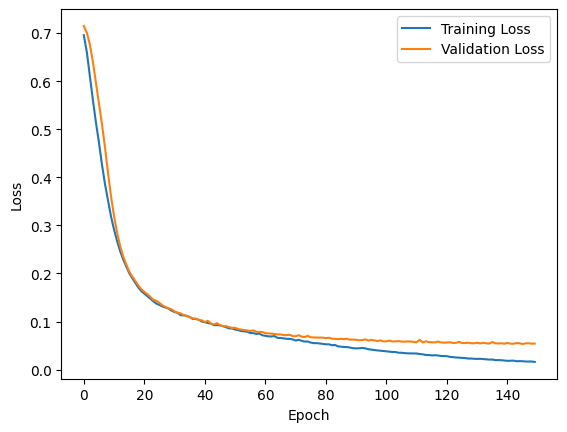

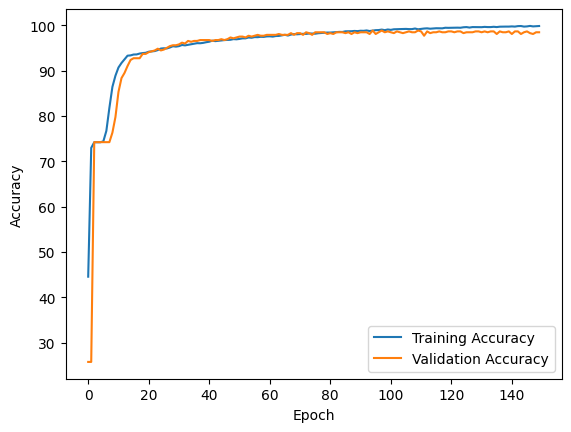

In [ ]:
trained_model = train_model(model, train_loader, val_loader, task, NUM_EPOCHS, lr)

In [ ]:
#save model checkpoints
os.makedirs('models/', exist_ok=True)
filename = 'models/PathMNIST_'+ str(SIZE_IMAGES) +'_'+ str(NUM_EPOCHS) +'.pth.tar'
torch.save({
                'epoch': NUM_EPOCHS,
                'state_dict': trained_model.state_dict()
            }, filename)

And evaluate it.

In [9]:
# Evaluation
def evaluate(model, test_loader, task):
    model.eval()
    y_true = []  # Store true labels
    pred = []  # Store predicted classes
    test_correct = 0
    test_total = 0

    with torch.no_grad():
      for images, labels in test_loader:
          images, labels = images.to(device), labels.to(device)
          outputs = model(images)

          if task == "multi-label, binary-class":
            labels = labels.to(torch.float32)  # Ensure float for BCEWithLogitsLoss
            outputs = torch.sigmoid(outputs)  # Apply sigmoid for binary classification
            predicted = (outputs >= 0.5).long()  # Threshold at 0.5 for binary classification
          else:
            labels = labels.squeeze().long() # Convert one-hot to class index
            _, predicted = torch.max(outputs, 1)  # Get predicted class index

          test_correct += (predicted == labels).sum().item()
          test_total += labels.size(0)

          # Collect the results
          y_true.append(labels.cpu().numpy())
          pred.append(predicted.cpu().numpy())

    # Convert to numpy arrays after gathering all results
    y_true = np.concatenate(y_true, axis=0)
    pred = np.concatenate(pred, axis=0)

    test_accuracy = 100 * test_correct / test_total
    print(f"Test Accuracy: {test_accuracy:.2f}%")

    # Compute test accuracy
    #acc = np.sum(y_true.flatten() == pred.flatten())/len(pred)*100
    #print(f"Test Accuracy: {acc:.2f}%")

    return y_true, pred



In [ ]:
y_true,pred = evaluate(trained_model, test_loader, task)

correct_images=np.where(y_true.flatten() == pred.flatten())[0]
wrong_images=np.where(~(y_true.flatten() == pred.flatten()))[0]

Test Accuracy: 81.57%


**Question**: Train it for at least 50 epochs and look at the training/validation evolution and then at the test score. Are you satisfied ? If not, what would you change ?  

After 50 epochs we reach an accuracy of 97% on the training and validation set. Indeed, after 50 epochs, it seems that our model is doing overfitting. However, we only reached an accuracy of 81% on the test dataset. This high difference,  may be explained by the fact that the dataset is not so big for deep learning (5000 samples).

This is not so sastifying for the results on the test set, there is a not negligible probability that we could say to someone that he has no pneumonia while he has...
To avoid overfitting, we could introduce early stopping, dropout and data augmentation.

Let's look at some correctly classified and wrongly classified images.

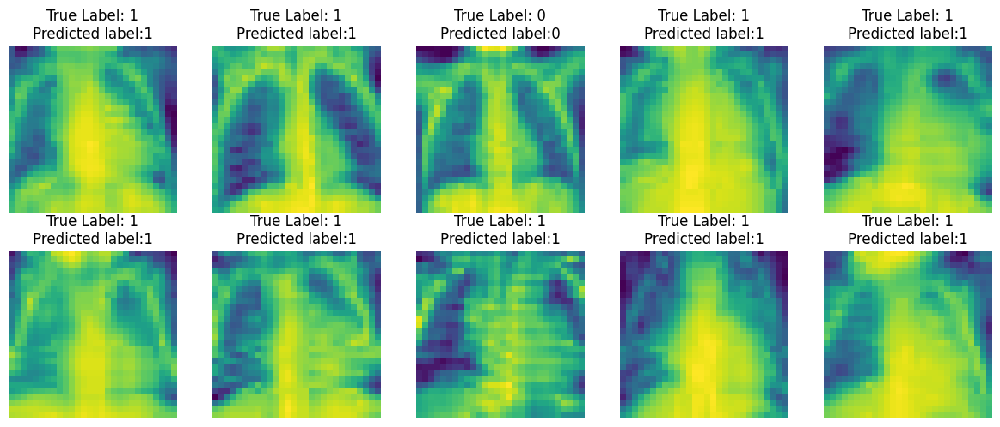

In [ ]:
# Correctly classified
fig, axes = plt.subplots(2, 5, figsize=(12, 5))

# Flatten axes for easy iteration
axes = axes.flatten()

selected_indices = correct_images[:10]

# Iterate through the selected indices
for i, idx in enumerate(selected_indices):
    image, label = test_loader.dataset[idx]  # Extract image and label

    # If image is RGB, swap dimensions from (C, H, W) to (H, W, C)
    mean=torch.tensor([.5])
    std=torch.tensor([.5])
    unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())
    img = np.clip(unnormalize(image).numpy(),0,1)
    img = img.transpose(1, 2, 0)  # Convert from PyTorch format to Matplotlib format

    axes[i].imshow(img)  # Adjust cmap if necessary
    axes[i].set_title(f"True Label: {label[0]}\nPredicted label:{pred[idx]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

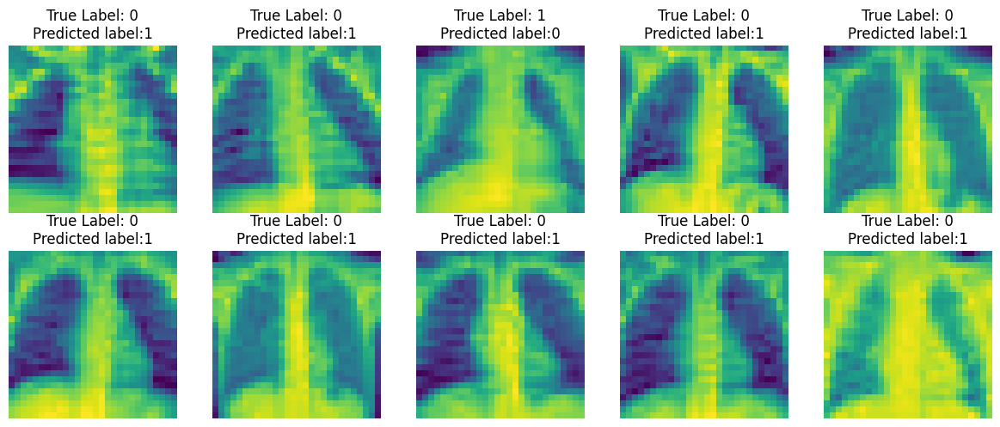

In [ ]:
# Wrongly classified
fig, axes = plt.subplots(2, 5, figsize=(12, 5))

# Flatten axes for easy iteration
axes = axes.flatten()

selected_indices = wrong_images[:10]

# Iterate through the selected indices
for i, idx in enumerate(selected_indices):
    image, label = test_loader.dataset[idx]  # Extract image and label

    # If image is RGB, swap dimensions from (C, H, W) to (H, W, C)
    mean=torch.tensor([.5])
    std=torch.tensor([.5])
    unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())
    img = np.clip(unnormalize(image).numpy(),0,1)
    img = img.transpose(1, 2, 0)  # Convert from PyTorch format to Matplotlib format

    axes[i].imshow(img)  # Adjust cmap if necessary
    axes[i].set_title(f"True Label: {label[0]}\nPredicted label:{pred[idx]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

**Question**: Can you see some patterns that could explain why the algorithm has wrongly classified these images ? At the lowest resolution (28x28) is very difficult (I would say impossible). Choose a higher resolution and train the same code.

Indeed it seems to be very difficult to explain why the algorithm missclassified some images with an image_size of 28.

**Question**: You probably found an error. Please change the `Net` code so that it can work with any input size. If you want to speed up computations, you can also change the number of channels. You can also change the optimization process if you wish.

In [12]:
# define a simple CNN model (from MedMNIST website)
class Net(nn.Module):
    def __init__(self, in_channels, num_classes, input_size):
        super(Net, self).__init__()

        self.layer1 = nn.Sequential(
            nn.Conv2d(in_channels, 16, kernel_size=3),
            nn.BatchNorm2d(16),
            nn.ReLU())

        self.layer2 = nn.Sequential(
            nn.Conv2d(16, 16, kernel_size=3),
            nn.BatchNorm2d(16),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2))

        self.layer3 = nn.Sequential(
            nn.Conv2d(16, 64, kernel_size=3),
            nn.BatchNorm2d(64),
            nn.ReLU())

        self.layer4 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3),
            nn.BatchNorm2d(64),
            nn.ReLU())

        self.layer5 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2))

        size = ((input_size - 2)//2 - 4)//2
        self.fc = nn.Sequential(
            nn.Linear(64 * size * size, 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, num_classes))

    def forward(self, x):
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        x = self.layer5(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)
        return x


In [ ]:
# Dataset Hyper-parameters
dataset_name = "pneumoniamnist"  # Change this to any MedMNIST dataset (e.g., "chestmnist", "bloodmnist")
SIZE_IMAGES = 128 # 28, 64, 128, 256
BATCH_SIZE = 1024

In [ ]:
# Run training on any MedMNIST dataset
train_dataset, val_dataset, test_dataset, train_loader, val_loader, test_loader, in_channels, num_classes, task = load_medmnist(dataset_name, BATCH_SIZE, SIZE_IMAGES)

print('The task is', task)
# Get image size from the dataset
image_size = train_loader.dataset.imgs.shape[1]  # Works for all MedMNIST datasets
print('The size of images is ', image_size)

100%|██████████| 75.5M/75.5M [00:06<00:00, 11.5MB/s]


Using downloaded and verified file: /root/.medmnist/pneumoniamnist_128.npz
Using downloaded and verified file: /root/.medmnist/pneumoniamnist_128.npz
The task is binary-class
The size of images is  128


In [ ]:
# Initialize model
model2 = Net(in_channels=in_channels, num_classes=num_classes, input_size=SIZE_IMAGES)

100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 1/150, Loss: 0.6137, Accuracy: 74.32%
Epoch 1/150, Val Loss: 0.6523, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:07<00:00,  1.49s/it]


Epoch 2/150, Loss: 0.4487, Accuracy: 81.61%
Epoch 2/150, Val Loss: 0.6125, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:07<00:00,  1.52s/it]


Epoch 3/150, Loss: 0.2746, Accuracy: 91.59%
Epoch 3/150, Val Loss: 0.5750, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:07<00:00,  1.45s/it]


Epoch 4/150, Loss: 0.1883, Accuracy: 93.29%
Epoch 4/150, Val Loss: 0.6314, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 5/150, Loss: 0.1520, Accuracy: 94.18%
Epoch 5/150, Val Loss: 0.7832, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:07<00:00,  1.40s/it]


Epoch 6/150, Loss: 0.1295, Accuracy: 94.84%
Epoch 6/150, Val Loss: 0.9724, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 7/150, Loss: 0.1133, Accuracy: 95.48%
Epoch 7/150, Val Loss: 1.1061, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 8/150, Loss: 0.1057, Accuracy: 95.94%
Epoch 8/150, Val Loss: 1.1239, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 9/150, Loss: 0.0969, Accuracy: 96.16%
Epoch 9/150, Val Loss: 0.9825, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:07<00:00,  1.49s/it]


Epoch 10/150, Loss: 0.0929, Accuracy: 96.41%
Epoch 10/150, Val Loss: 0.8009, Val Accuracy: 74.24%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 11/150, Loss: 0.0898, Accuracy: 96.50%
Epoch 11/150, Val Loss: 0.5674, Val Accuracy: 78.05%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 12/150, Loss: 0.0866, Accuracy: 96.69%
Epoch 12/150, Val Loss: 0.4324, Val Accuracy: 82.25%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 13/150, Loss: 0.0827, Accuracy: 96.71%
Epoch 13/150, Val Loss: 0.2701, Val Accuracy: 88.17%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 14/150, Loss: 0.0814, Accuracy: 97.03%
Epoch 14/150, Val Loss: 0.2096, Val Accuracy: 91.98%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 15/150, Loss: 0.0793, Accuracy: 97.07%
Epoch 15/150, Val Loss: 0.1561, Val Accuracy: 93.51%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 16/150, Loss: 0.0757, Accuracy: 97.28%
Epoch 16/150, Val Loss: 0.1173, Val Accuracy: 95.23%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 17/150, Loss: 0.0746, Accuracy: 97.37%
Epoch 17/150, Val Loss: 0.1241, Val Accuracy: 94.85%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 18/150, Loss: 0.0724, Accuracy: 97.58%
Epoch 18/150, Val Loss: 0.0985, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.40s/it]


Epoch 19/150, Loss: 0.0668, Accuracy: 97.62%
Epoch 19/150, Val Loss: 0.0975, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 20/150, Loss: 0.0655, Accuracy: 97.81%
Epoch 20/150, Val Loss: 0.1045, Val Accuracy: 96.37%


100%|██████████| 5/5 [00:07<00:00,  1.45s/it]


Epoch 21/150, Loss: 0.0641, Accuracy: 97.88%
Epoch 21/150, Val Loss: 0.0943, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.40s/it]


Epoch 22/150, Loss: 0.0613, Accuracy: 97.85%
Epoch 22/150, Val Loss: 0.0935, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.45s/it]


Epoch 23/150, Loss: 0.0596, Accuracy: 98.09%
Epoch 23/150, Val Loss: 0.0970, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 24/150, Loss: 0.0585, Accuracy: 98.13%
Epoch 24/150, Val Loss: 0.0934, Val Accuracy: 96.56%


100%|██████████| 5/5 [00:07<00:00,  1.57s/it]


Epoch 25/150, Loss: 0.0563, Accuracy: 98.24%
Epoch 25/150, Val Loss: 0.0918, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.58s/it]


Epoch 26/150, Loss: 0.0555, Accuracy: 98.19%
Epoch 26/150, Val Loss: 0.0923, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 27/150, Loss: 0.0538, Accuracy: 98.28%
Epoch 27/150, Val Loss: 0.0900, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.49s/it]


Epoch 28/150, Loss: 0.0525, Accuracy: 98.43%
Epoch 28/150, Val Loss: 0.0910, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 29/150, Loss: 0.0512, Accuracy: 98.36%
Epoch 29/150, Val Loss: 0.0895, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.48s/it]


Epoch 30/150, Loss: 0.0488, Accuracy: 98.53%
Epoch 30/150, Val Loss: 0.0902, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.47s/it]


Epoch 31/150, Loss: 0.0470, Accuracy: 98.58%
Epoch 31/150, Val Loss: 0.0902, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 32/150, Loss: 0.0448, Accuracy: 98.73%
Epoch 32/150, Val Loss: 0.0894, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 33/150, Loss: 0.0439, Accuracy: 98.68%
Epoch 33/150, Val Loss: 0.0882, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 34/150, Loss: 0.0432, Accuracy: 98.81%
Epoch 34/150, Val Loss: 0.0883, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 35/150, Loss: 0.0423, Accuracy: 98.79%
Epoch 35/150, Val Loss: 0.0876, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 36/150, Loss: 0.0409, Accuracy: 98.94%
Epoch 36/150, Val Loss: 0.0884, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.45s/it]


Epoch 37/150, Loss: 0.0394, Accuracy: 98.85%
Epoch 37/150, Val Loss: 0.0865, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 38/150, Loss: 0.0372, Accuracy: 99.09%
Epoch 38/150, Val Loss: 0.0881, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.48s/it]


Epoch 39/150, Loss: 0.0359, Accuracy: 98.96%
Epoch 39/150, Val Loss: 0.0868, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 40/150, Loss: 0.0358, Accuracy: 99.00%
Epoch 40/150, Val Loss: 0.0867, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 41/150, Loss: 0.0351, Accuracy: 99.07%
Epoch 41/150, Val Loss: 0.0865, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.48s/it]


Epoch 42/150, Loss: 0.0330, Accuracy: 99.17%
Epoch 42/150, Val Loss: 0.0863, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 43/150, Loss: 0.0311, Accuracy: 99.24%
Epoch 43/150, Val Loss: 0.0874, Val Accuracy: 96.37%


100%|██████████| 5/5 [00:07<00:00,  1.49s/it]


Epoch 44/150, Loss: 0.0307, Accuracy: 99.30%
Epoch 44/150, Val Loss: 0.0852, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:08<00:00,  1.62s/it]


Epoch 45/150, Loss: 0.0285, Accuracy: 99.41%
Epoch 45/150, Val Loss: 0.0859, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.40s/it]


Epoch 46/150, Loss: 0.0286, Accuracy: 99.32%
Epoch 46/150, Val Loss: 0.0855, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 47/150, Loss: 0.0268, Accuracy: 99.45%
Epoch 47/150, Val Loss: 0.0859, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 48/150, Loss: 0.0256, Accuracy: 99.47%
Epoch 48/150, Val Loss: 0.0852, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 49/150, Loss: 0.0250, Accuracy: 99.51%
Epoch 49/150, Val Loss: 0.0852, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.48s/it]


Epoch 50/150, Loss: 0.0238, Accuracy: 99.49%
Epoch 50/150, Val Loss: 0.0859, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 51/150, Loss: 0.0231, Accuracy: 99.58%
Epoch 51/150, Val Loss: 0.0858, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 52/150, Loss: 0.0226, Accuracy: 99.53%
Epoch 52/150, Val Loss: 0.0853, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 53/150, Loss: 0.0216, Accuracy: 99.60%
Epoch 53/150, Val Loss: 0.0851, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 54/150, Loss: 0.0212, Accuracy: 99.64%
Epoch 54/150, Val Loss: 0.0852, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.45s/it]


Epoch 55/150, Loss: 0.0202, Accuracy: 99.64%
Epoch 55/150, Val Loss: 0.0854, Val Accuracy: 96.56%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 56/150, Loss: 0.0203, Accuracy: 99.70%
Epoch 56/150, Val Loss: 0.0841, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 57/150, Loss: 0.0188, Accuracy: 99.68%
Epoch 57/150, Val Loss: 0.0854, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 58/150, Loss: 0.0178, Accuracy: 99.70%
Epoch 58/150, Val Loss: 0.0849, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 59/150, Loss: 0.0181, Accuracy: 99.66%
Epoch 59/150, Val Loss: 0.0856, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.47s/it]


Epoch 60/150, Loss: 0.0171, Accuracy: 99.72%
Epoch 60/150, Val Loss: 0.0844, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 61/150, Loss: 0.0161, Accuracy: 99.77%
Epoch 61/150, Val Loss: 0.0852, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 62/150, Loss: 0.0159, Accuracy: 99.77%
Epoch 62/150, Val Loss: 0.0853, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 63/150, Loss: 0.0152, Accuracy: 99.81%
Epoch 63/150, Val Loss: 0.0851, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 64/150, Loss: 0.0146, Accuracy: 99.77%
Epoch 64/150, Val Loss: 0.0853, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 65/150, Loss: 0.0140, Accuracy: 99.83%
Epoch 65/150, Val Loss: 0.0859, Val Accuracy: 96.37%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 66/150, Loss: 0.0136, Accuracy: 99.85%
Epoch 66/150, Val Loss: 0.0850, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 67/150, Loss: 0.0133, Accuracy: 99.85%
Epoch 67/150, Val Loss: 0.0859, Val Accuracy: 96.37%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 68/150, Loss: 0.0133, Accuracy: 99.83%
Epoch 68/150, Val Loss: 0.0851, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 69/150, Loss: 0.0124, Accuracy: 99.89%
Epoch 69/150, Val Loss: 0.0859, Val Accuracy: 96.37%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 70/150, Loss: 0.0125, Accuracy: 99.92%
Epoch 70/150, Val Loss: 0.0852, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 71/150, Loss: 0.0115, Accuracy: 99.94%
Epoch 71/150, Val Loss: 0.0884, Val Accuracy: 96.37%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 72/150, Loss: 0.0112, Accuracy: 99.92%
Epoch 72/150, Val Loss: 0.0861, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 73/150, Loss: 0.0110, Accuracy: 99.92%
Epoch 73/150, Val Loss: 0.0867, Val Accuracy: 96.56%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 74/150, Loss: 0.0106, Accuracy: 99.94%
Epoch 74/150, Val Loss: 0.0871, Val Accuracy: 96.37%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 75/150, Loss: 0.0100, Accuracy: 99.96%
Epoch 75/150, Val Loss: 0.0870, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.45s/it]


Epoch 76/150, Loss: 0.0100, Accuracy: 99.96%
Epoch 76/150, Val Loss: 0.0876, Val Accuracy: 96.37%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 77/150, Loss: 0.0094, Accuracy: 99.98%
Epoch 77/150, Val Loss: 0.0869, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 78/150, Loss: 0.0094, Accuracy: 99.96%
Epoch 78/150, Val Loss: 0.0871, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 79/150, Loss: 0.0090, Accuracy: 99.96%
Epoch 79/150, Val Loss: 0.0873, Val Accuracy: 96.56%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 80/150, Loss: 0.0089, Accuracy: 99.98%
Epoch 80/150, Val Loss: 0.0874, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.49s/it]


Epoch 81/150, Loss: 0.0086, Accuracy: 100.00%
Epoch 81/150, Val Loss: 0.0873, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 82/150, Loss: 0.0081, Accuracy: 99.98%
Epoch 82/150, Val Loss: 0.0876, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 83/150, Loss: 0.0081, Accuracy: 100.00%
Epoch 83/150, Val Loss: 0.0887, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 84/150, Loss: 0.0078, Accuracy: 100.00%
Epoch 84/150, Val Loss: 0.0880, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.45s/it]


Epoch 85/150, Loss: 0.0075, Accuracy: 100.00%
Epoch 85/150, Val Loss: 0.0885, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 86/150, Loss: 0.0074, Accuracy: 100.00%
Epoch 86/150, Val Loss: 0.0887, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.45s/it]


Epoch 87/150, Loss: 0.0073, Accuracy: 100.00%
Epoch 87/150, Val Loss: 0.0888, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 88/150, Loss: 0.0069, Accuracy: 100.00%
Epoch 88/150, Val Loss: 0.0888, Val Accuracy: 96.95%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 89/150, Loss: 0.0069, Accuracy: 100.00%
Epoch 89/150, Val Loss: 0.0891, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 90/150, Loss: 0.0067, Accuracy: 100.00%
Epoch 90/150, Val Loss: 0.0888, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:06<00:00,  1.40s/it]


Epoch 91/150, Loss: 0.0065, Accuracy: 100.00%
Epoch 91/150, Val Loss: 0.0893, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 92/150, Loss: 0.0066, Accuracy: 100.00%
Epoch 92/150, Val Loss: 0.0889, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 93/150, Loss: 0.0062, Accuracy: 100.00%
Epoch 93/150, Val Loss: 0.0894, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 94/150, Loss: 0.0060, Accuracy: 100.00%
Epoch 94/150, Val Loss: 0.0893, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 95/150, Loss: 0.0059, Accuracy: 100.00%
Epoch 95/150, Val Loss: 0.0896, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 96/150, Loss: 0.0057, Accuracy: 100.00%
Epoch 96/150, Val Loss: 0.0901, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 97/150, Loss: 0.0057, Accuracy: 100.00%
Epoch 97/150, Val Loss: 0.0900, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 98/150, Loss: 0.0055, Accuracy: 100.00%
Epoch 98/150, Val Loss: 0.0905, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.40s/it]


Epoch 99/150, Loss: 0.0053, Accuracy: 100.00%
Epoch 99/150, Val Loss: 0.0907, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 100/150, Loss: 0.0055, Accuracy: 100.00%
Epoch 100/150, Val Loss: 0.0905, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 101/150, Loss: 0.0052, Accuracy: 100.00%
Epoch 101/150, Val Loss: 0.0910, Val Accuracy: 96.56%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 102/150, Loss: 0.0051, Accuracy: 100.00%
Epoch 102/150, Val Loss: 0.0905, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 103/150, Loss: 0.0052, Accuracy: 100.00%
Epoch 103/150, Val Loss: 0.0907, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 104/150, Loss: 0.0051, Accuracy: 100.00%
Epoch 104/150, Val Loss: 0.0919, Val Accuracy: 96.56%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 105/150, Loss: 0.0051, Accuracy: 100.00%
Epoch 105/150, Val Loss: 0.0908, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 106/150, Loss: 0.0047, Accuracy: 100.00%
Epoch 106/150, Val Loss: 0.0912, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 107/150, Loss: 0.0046, Accuracy: 100.00%
Epoch 107/150, Val Loss: 0.0913, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 108/150, Loss: 0.0045, Accuracy: 100.00%
Epoch 108/150, Val Loss: 0.0918, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 109/150, Loss: 0.0044, Accuracy: 100.00%
Epoch 109/150, Val Loss: 0.0923, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 110/150, Loss: 0.0043, Accuracy: 100.00%
Epoch 110/150, Val Loss: 0.0918, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 111/150, Loss: 0.0042, Accuracy: 100.00%
Epoch 111/150, Val Loss: 0.0925, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 112/150, Loss: 0.0042, Accuracy: 100.00%
Epoch 112/150, Val Loss: 0.0928, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 113/150, Loss: 0.0041, Accuracy: 100.00%
Epoch 113/150, Val Loss: 0.0933, Val Accuracy: 96.56%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 114/150, Loss: 0.0041, Accuracy: 100.00%
Epoch 114/150, Val Loss: 0.0922, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 115/150, Loss: 0.0039, Accuracy: 100.00%
Epoch 115/150, Val Loss: 0.0927, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 116/150, Loss: 0.0039, Accuracy: 100.00%
Epoch 116/150, Val Loss: 0.0932, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.40s/it]


Epoch 117/150, Loss: 0.0038, Accuracy: 100.00%
Epoch 117/150, Val Loss: 0.0930, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 118/150, Loss: 0.0037, Accuracy: 100.00%
Epoch 118/150, Val Loss: 0.0934, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 119/150, Loss: 0.0037, Accuracy: 100.00%
Epoch 119/150, Val Loss: 0.0933, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 120/150, Loss: 0.0037, Accuracy: 100.00%
Epoch 120/150, Val Loss: 0.0930, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.49s/it]


Epoch 121/150, Loss: 0.0035, Accuracy: 100.00%
Epoch 121/150, Val Loss: 0.0943, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 122/150, Loss: 0.0035, Accuracy: 100.00%
Epoch 122/150, Val Loss: 0.0940, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 123/150, Loss: 0.0034, Accuracy: 100.00%
Epoch 123/150, Val Loss: 0.0937, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.45s/it]


Epoch 124/150, Loss: 0.0033, Accuracy: 100.00%
Epoch 124/150, Val Loss: 0.0947, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.40s/it]


Epoch 125/150, Loss: 0.0033, Accuracy: 100.00%
Epoch 125/150, Val Loss: 0.0942, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 126/150, Loss: 0.0032, Accuracy: 100.00%
Epoch 126/150, Val Loss: 0.0942, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.45s/it]


Epoch 127/150, Loss: 0.0031, Accuracy: 100.00%
Epoch 127/150, Val Loss: 0.0946, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 128/150, Loss: 0.0031, Accuracy: 100.00%
Epoch 128/150, Val Loss: 0.0949, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 129/150, Loss: 0.0032, Accuracy: 100.00%
Epoch 129/150, Val Loss: 0.0946, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 130/150, Loss: 0.0030, Accuracy: 100.00%
Epoch 130/150, Val Loss: 0.0951, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 131/150, Loss: 0.0030, Accuracy: 100.00%
Epoch 131/150, Val Loss: 0.0950, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 132/150, Loss: 0.0030, Accuracy: 100.00%
Epoch 132/150, Val Loss: 0.0945, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 133/150, Loss: 0.0030, Accuracy: 100.00%
Epoch 133/150, Val Loss: 0.0953, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 134/150, Loss: 0.0029, Accuracy: 100.00%
Epoch 134/150, Val Loss: 0.0952, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 135/150, Loss: 0.0029, Accuracy: 100.00%
Epoch 135/150, Val Loss: 0.0953, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.40s/it]


Epoch 136/150, Loss: 0.0028, Accuracy: 100.00%
Epoch 136/150, Val Loss: 0.0952, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 137/150, Loss: 0.0028, Accuracy: 100.00%
Epoch 137/150, Val Loss: 0.0956, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 138/150, Loss: 0.0027, Accuracy: 100.00%
Epoch 138/150, Val Loss: 0.0954, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 139/150, Loss: 0.0027, Accuracy: 100.00%
Epoch 139/150, Val Loss: 0.0957, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 140/150, Loss: 0.0027, Accuracy: 100.00%
Epoch 140/150, Val Loss: 0.0962, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 141/150, Loss: 0.0026, Accuracy: 100.00%
Epoch 141/150, Val Loss: 0.0959, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


Epoch 142/150, Loss: 0.0026, Accuracy: 100.00%
Epoch 142/150, Val Loss: 0.0961, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


Epoch 143/150, Loss: 0.0026, Accuracy: 100.00%
Epoch 143/150, Val Loss: 0.0966, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 144/150, Loss: 0.0025, Accuracy: 100.00%
Epoch 144/150, Val Loss: 0.0962, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.47s/it]


Epoch 145/150, Loss: 0.0024, Accuracy: 100.00%
Epoch 145/150, Val Loss: 0.0966, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 146/150, Loss: 0.0024, Accuracy: 100.00%
Epoch 146/150, Val Loss: 0.0967, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


Epoch 147/150, Loss: 0.0024, Accuracy: 100.00%
Epoch 147/150, Val Loss: 0.0966, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.45s/it]


Epoch 148/150, Loss: 0.0024, Accuracy: 100.00%
Epoch 148/150, Val Loss: 0.0967, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.41s/it]


Epoch 149/150, Loss: 0.0024, Accuracy: 100.00%
Epoch 149/150, Val Loss: 0.0968, Val Accuracy: 96.76%


100%|██████████| 5/5 [00:07<00:00,  1.43s/it]


Epoch 150/150, Loss: 0.0023, Accuracy: 100.00%
Epoch 150/150, Val Loss: 0.0970, Val Accuracy: 96.76%


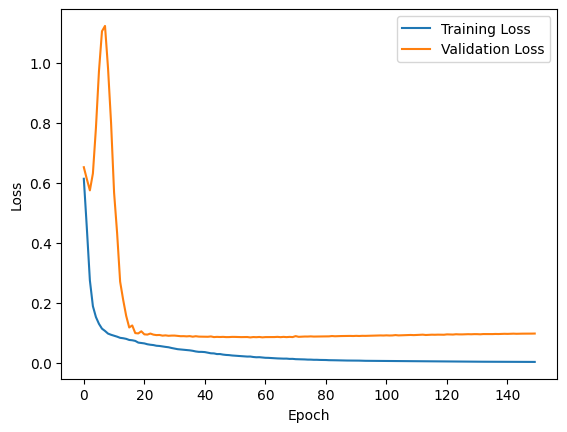

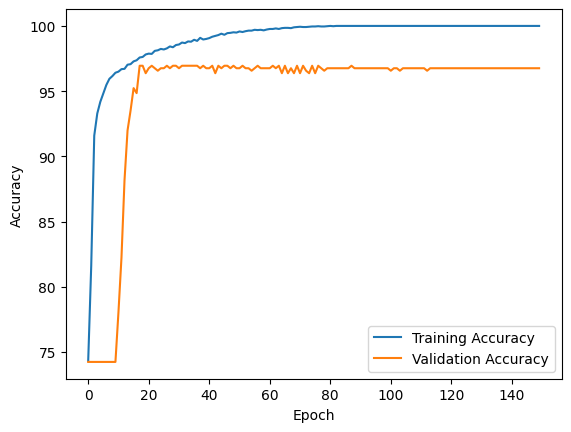

In [ ]:
trained_model_2 = train_model(model2, train_loader, val_loader, task, NUM_EPOCHS, lr)

In [ ]:
#save model checkpoints
os.makedirs('models/', exist_ok=True)
filename = 'models/PathMNIST_'+ str(SIZE_IMAGES) +'_'+ str(NUM_EPOCHS) +'.pth.tar'
torch.save({
                'epoch': NUM_EPOCHS,
                'state_dict': trained_model.state_dict()
            }, filename)

In [ ]:
y_true,pred = evaluate(trained_model_2, test_loader, task)

correct_images=np.where(y_true.flatten() == pred.flatten())[0]
wrong_images=np.where(~(y_true.flatten() == pred.flatten()))[0]

Test Accuracy: 83.97%


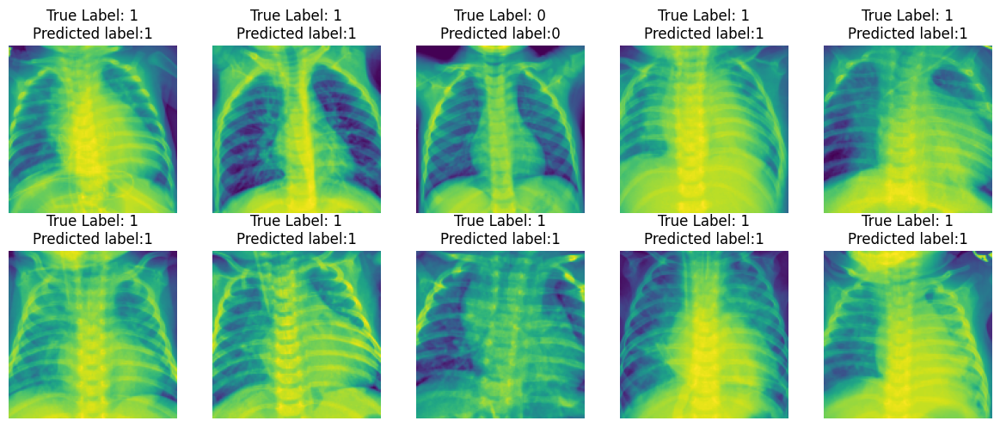

In [ ]:
# Correctly classified
fig, axes = plt.subplots(2, 5, figsize=(12, 5))

# Flatten axes for easy iteration
axes = axes.flatten()

selected_indices = correct_images[:10]

# Iterate through the selected indices
for i, idx in enumerate(selected_indices):
    image, label = test_loader.dataset[idx]  # Extract image and label

    # If image is RGB, swap dimensions from (C, H, W) to (H, W, C)
    mean=torch.tensor([.5])
    std=torch.tensor([.5])
    unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())
    img = np.clip(unnormalize(image).numpy(),0,1)
    img = img.transpose(1, 2, 0)  # Convert from PyTorch format to Matplotlib format

    axes[i].imshow(img)  # Adjust cmap if necessary
    axes[i].set_title(f"True Label: {label[0]}\nPredicted label:{pred[idx]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

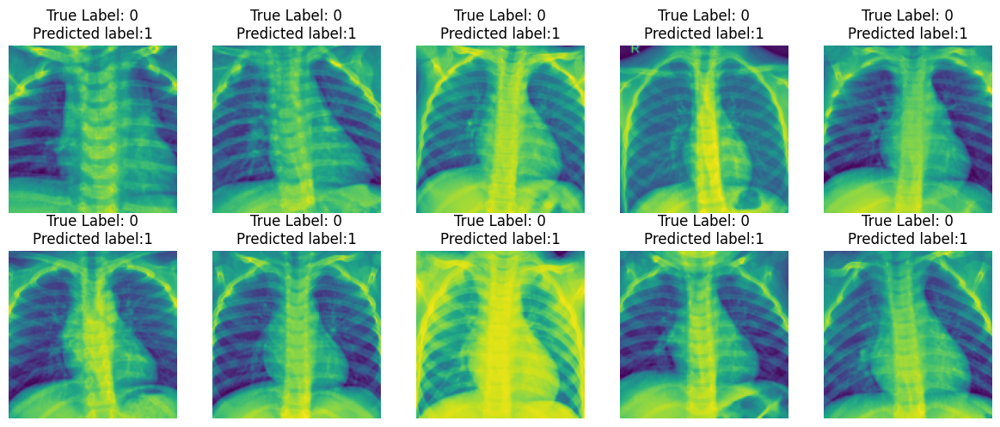

In [ ]:
# Wrongly classified
fig, axes = plt.subplots(2, 5, figsize=(12, 5))

# Flatten axes for easy iteration
axes = axes.flatten()

selected_indices = wrong_images[:10]

# Iterate through the selected indices
for i, idx in enumerate(selected_indices):
    image, label = test_loader.dataset[idx]  # Extract image and label

    # If image is RGB, swap dimensions from (C, H, W) to (H, W, C)
    mean=torch.tensor([.5])
    std=torch.tensor([.5])
    unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())
    img = np.clip(unnormalize(image).numpy(),0,1)
    img = img.transpose(1, 2, 0)  # Convert from PyTorch format to Matplotlib format

    axes[i].imshow(img)  # Adjust cmap if necessary
    axes[i].set_title(f"True Label: {label[0]}\nPredicted label:{pred[idx]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

**Question**: Now that you have a working code. Implement and use at **two**  explainability methods seen during the lecture of today (e.g., Attribution, CAM, LIME) on at least **two** different networks and **two** MedMNIST datasets (e.g., PathMNISt and DermaMNIST). You can use the image size you want (the bigger, the easier to interpret but the more computational capability you will need, please choose according to your computational capability).
As network, you can use the modified `Net`and either a pre-trained Pytorch one (such as ResNet) or another custom one of your choice.

##### Last layer embedding visualization

In [74]:
from sklearn.decomposition import PCA


def plot_last_layer_embeddings_representation_model_net(model, dataloader, num_classes):
    model.eval()

    for i, idx in enumerate(range(len(dataloader.dataset))):
        image, label = dataloader.dataset[idx]  # Extract image and label
        image = image.unsqueeze(0).to(device)

        with torch.no_grad():
          last_layer_embedding = model.layer5(model.layer4(model.layer3(model.layer2(model.layer1(image)))))
          last_layer_embedding = last_layer_embedding.view(last_layer_embedding.size(0), -1)
          last_layer_embedding = model.fc[0](last_layer_embedding)
          last_layer_embedding = last_layer_embedding.squeeze(0)

          if i == 1:
            last_layer_embeddings = torch.stack((last_layer_embeddings, last_layer_embedding), 0)
            labels = np.append(labels, label[0])

          elif i > 1:
            last_layer_embeddings = torch.cat((last_layer_embeddings, last_layer_embedding.unsqueeze(0)), 0)
            labels = np.append(labels, label[0])

          else:
            last_layer_embeddings = last_layer_embedding
            labels = label[0]


    embeddings_pca = PCA(n_components=2).fit_transform(last_layer_embeddings.cpu())

    plt.scatter(embeddings_pca[:, 0], embeddings_pca[:, 1], c=labels, cmap = plt.get_cmap('tab10', num_classes), marker='o')
    plt.title('PCA Embedding of the test dataset with ground truth Labels')

    plt.tight_layout()
    plt.show()

In [75]:
def plot_last_layer_embeddings_representation_resnet(model, dataloader, num_classes):
    #remove the final fully connected layer
    model.fc = nn.Identity()
    model.eval()

    for i, idx in enumerate(range(len(dataloader.dataset))):
        image, label = dataloader.dataset[idx]  # Extract image and label
        image = image.unsqueeze(0).to(device)

        with torch.no_grad():
          last_layer_embedding = model(image)

          if i == 1:
            last_layer_embeddings = torch.stack((last_layer_embeddings, last_layer_embedding), 0)
            labels = np.append(labels, label[0])

          elif i > 1:
            last_layer_embeddings = torch.cat((last_layer_embeddings, last_layer_embedding.unsqueeze(0)), 0)
            labels = np.append(labels, label[0])

          else:
            last_layer_embeddings = last_layer_embedding
            labels = label[0]

    last_layer_embeddings = last_layer_embeddings.squeeze(1)
    print(last_layer_embeddings.shape)
    embeddings_pca = PCA(n_components=2).fit_transform(last_layer_embeddings.cpu())

    plt.scatter(embeddings_pca[:, 0], embeddings_pca[:, 1], c=labels, cmap = plt.get_cmap('tab10', num_classes), marker='o')
    plt.title('PCA Embedding of the test dataset with ground truth Labels')

    plt.tight_layout()
    plt.show()

##### Grad-CAM

In [76]:
import cv2
def save_gradient(grad):
    global gradients
    gradients = grad

#Hook to capture the activations and gradients from the last convolutional layer
def register_hooks(module, input, output):
    global activations
    activations = output
    output.register_hook(save_gradient)  # register hook for gradients during the backward pass


# function to generate Grad-CAM
def generate_gradcam(model, image, target_class, image_size = SIZE_IMAGES):
    output = model(image)
    model.zero_grad()

    #get the score for the target class
    target = output[0, target_class]

    #Backward pass to calculate gradients with respect to the target class
    target.backward()

    # global average pooling of the gradients over the spatial dimensions
    pooled_gradients = torch.mean(gradients, dim=[0, 2, 3])

    #get the activations (feature maps)
    activations_np = activations.detach().cpu().numpy()[0]

    #multiply the activations by the pooled gradients
    for i in range(len(pooled_gradients)):
        activations_np[i, :, :] *= pooled_gradients[i].detach().cpu().numpy()

    #average the feature maps along the channel dimension to get the CAM
    cam = np.mean(activations_np, axis=0)
    cam = np.maximum(cam, 0)
    cam = (cam - cam.min()) / (cam.max() - cam.min())

    # Resize CAM to match the input image size
    cam = Image.fromarray(np.uint8(cam * 255)).resize((image_size, image_size), Image.LANCZOS)
    return cam

#Function to visualize the original image and Grad-CAM overlay
def show_cam_on_image(input_image, cam):
    img_np = np.transpose(input_image.squeeze().cpu().numpy(), (1, 2, 0))
    img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min())

    cam_np = np.array(cam) / 255.0
    cam_colored = cv2.applyColorMap(np.uint8(255 * cam_np), cv2.COLORMAP_JET)
    cam_colored = cam_colored.astype(np.float32) / 255.0

    overlay_img = 0.6 * cam_colored + 0.4 * img_np

    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(img_np)
    plt.axis('off')
    plt.title("Original Image")

    plt.subplot(1, 2, 2)
    plt.imshow(overlay_img)
    plt.axis('off')
    plt.title("Grad-CAM Overlay")

    plt.show()

In [77]:
#function to process and plot Grad-CAM for a batch of images
def plot_grad_cam_resnet(model, dataloader, image_size = SIZE_IMAGES):
    model.eval()

    idx_list = np.random.choice(len(dataloader.dataset), 10, replace=False)
    for idx in idx_list:
        input_image, label = dataloader.dataset[idx]

        input_image = input_image.unsqueeze(0).to(device)
        input_image_clone = input_image.clone()

        # hook to capture activations and gradients
        layer = model.layer4[1].conv2
        layer.register_forward_hook(register_hooks)

        output = model(input_image)
        _, pred_class = output.max(1)

        #generate Grad-CAM for the predicted class
        cam = generate_gradcam(model, input_image, pred_class.item(), image_size)

        #show the original image and Grad-CAM overlay
        show_cam_on_image(input_image_clone, cam)

In [78]:
#function to process and plot Grad-CAM for a batch of images
def plot_grad_cam_model_net(model, dataloader, image_size = SIZE_IMAGES):
    model.eval()

    idx_list = np.random.choice(len(dataloader.dataset), 10, replace=False)
    for idx in idx_list:
        input_image, label = dataloader.dataset[idx]

        input_image = input_image.unsqueeze(0).to(device)
        input_image_clone = input_image.clone()

        # hook to capture activations and gradients
        layer = model.layer5[0]
        layer.register_forward_hook(register_hooks)

        output = model(input_image)
        _, pred_class = output.max(1)

        #Generate Grad-CAM for the predicted class
        cam = generate_gradcam(model, input_image, pred_class.item(), image_size)

        #show the original image and Grad-CAM overlay
        show_cam_on_image(input_image_clone, cam)

#### PathMNIST dataset

In [79]:
# Dataset Hyper-parameters
dataset_name = "pathmnist"  # Change this to any MedMNIST dataset (e.g., "chestmnist", "bloodmnist")
SIZE_IMAGES = 128 # 28, 64, 128, 256
BATCH_SIZE = 1024

In [80]:
# Run training on any MedMNIST dataset
train_dataset, val_dataset, test_dataset, train_loader, val_loader, test_loader, in_channels, num_classes, task = load_medmnist(dataset_name, BATCH_SIZE, SIZE_IMAGES)

print('The task is', task)
# Get image size from the dataset
image_size = train_loader.dataset.imgs.shape[1]  # Works for all MedMNIST datasets
print('The size of images is ', image_size)

100%|██████████| 4.26G/4.26G [04:07<00:00, 17.2MB/s]


Using downloaded and verified file: /root/.medmnist/pathmnist_128.npz
Using downloaded and verified file: /root/.medmnist/pathmnist_128.npz
The task is multi-class
The size of images is  128


In [81]:
# Initialize model
model_net = Net(in_channels=in_channels, num_classes=num_classes, input_size=SIZE_IMAGES)

In [82]:
# Optimization Hyper-parameters
NUM_EPOCHS = 8
lr = 0.001

100%|██████████| 88/88 [02:52<00:00,  1.96s/it]


Epoch 1/8, Loss: 1.2323, Accuracy: 56.99%
Epoch 1/8, Val Loss: 0.9140, Val Accuracy: 73.48%


100%|██████████| 88/88 [02:44<00:00,  1.87s/it]


Epoch 2/8, Loss: 0.6117, Accuracy: 77.93%
Epoch 2/8, Val Loss: 0.7267, Val Accuracy: 78.11%


100%|██████████| 88/88 [02:50<00:00,  1.94s/it]


Epoch 3/8, Loss: 0.4920, Accuracy: 82.45%
Epoch 3/8, Val Loss: 0.5427, Val Accuracy: 85.05%


100%|██████████| 88/88 [02:50<00:00,  1.94s/it]


Epoch 4/8, Loss: 0.4071, Accuracy: 85.82%
Epoch 4/8, Val Loss: 0.5006, Val Accuracy: 85.93%


100%|██████████| 88/88 [02:47<00:00,  1.91s/it]


Epoch 5/8, Loss: 0.3399, Accuracy: 88.35%
Epoch 5/8, Val Loss: 0.4577, Val Accuracy: 87.15%


100%|██████████| 88/88 [02:49<00:00,  1.93s/it]


Epoch 6/8, Loss: 0.2841, Accuracy: 90.42%
Epoch 6/8, Val Loss: 0.4374, Val Accuracy: 87.77%


100%|██████████| 88/88 [02:50<00:00,  1.94s/it]


Epoch 7/8, Loss: 0.2462, Accuracy: 91.82%
Epoch 7/8, Val Loss: 0.3246, Val Accuracy: 91.43%


100%|██████████| 88/88 [02:50<00:00,  1.94s/it]


Epoch 8/8, Loss: 0.2115, Accuracy: 93.16%
Epoch 8/8, Val Loss: 0.3180, Val Accuracy: 91.25%


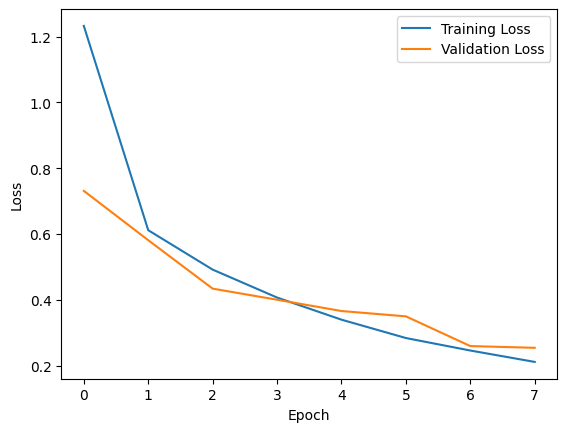

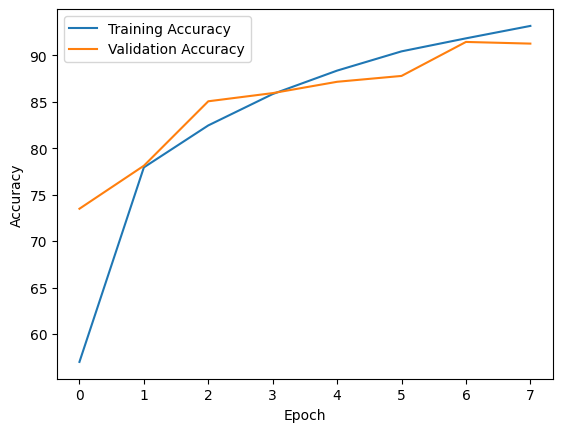

In [83]:
trained_model_net = train_model(model_net, train_loader, val_loader, task, NUM_EPOCHS, lr)

In [84]:
y_true,pred = evaluate(trained_model_net, test_loader, task)

correct_images=np.where(y_true.flatten() == pred.flatten())[0]
wrong_images=np.where(~(y_true.flatten() == pred.flatten()))[0]

Test Accuracy: 80.99%


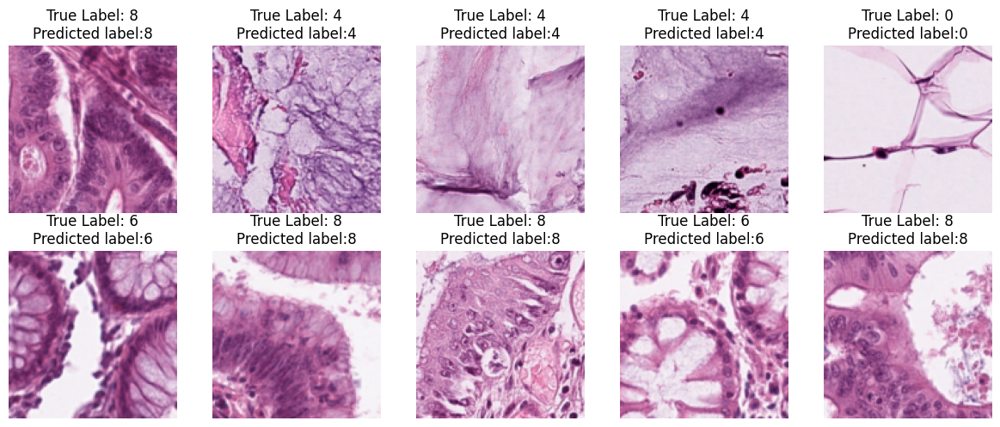

In [85]:
# Correctly classified
fig, axes = plt.subplots(2, 5, figsize=(12, 5))

# Flatten axes for easy iteration
axes = axes.flatten()

selected_indices = correct_images[:10]

# Iterate through the selected indices
for i, idx in enumerate(selected_indices):
    image, label = test_loader.dataset[idx]  # Extract image and label

    # If image is RGB, swap dimensions from (C, H, W) to (H, W, C)
    mean=torch.tensor([.5])
    std=torch.tensor([.5])
    unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())
    img = np.clip(unnormalize(image).numpy(),0,1)
    img = img.transpose(1, 2, 0)  # Convert from PyTorch format to Matplotlib format

    axes[i].imshow(img)  # Adjust cmap if necessary
    axes[i].set_title(f"True Label: {label[0]}\nPredicted label:{pred[idx]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

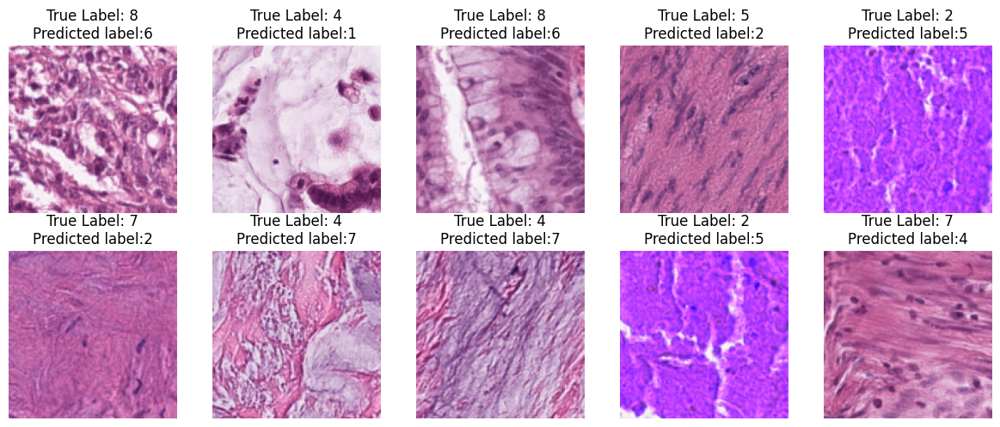

In [86]:
# Wrongly classified
fig, axes = plt.subplots(2, 5, figsize=(12, 5))

# Flatten axes for easy iteration
axes = axes.flatten()

selected_indices = wrong_images[:10]

# Iterate through the selected indices
for i, idx in enumerate(selected_indices):
    image, label = test_loader.dataset[idx]  # Extract image and label

    # If image is RGB, swap dimensions from (C, H, W) to (H, W, C)
    mean=torch.tensor([.5])
    std=torch.tensor([.5])
    unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())
    img = np.clip(unnormalize(image).numpy(),0,1)
    img = img.transpose(1, 2, 0)  # Convert from PyTorch format to Matplotlib format

    axes[i].imshow(img)  # Adjust cmap if necessary
    axes[i].set_title(f"True Label: {label[0]}\nPredicted label:{pred[idx]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

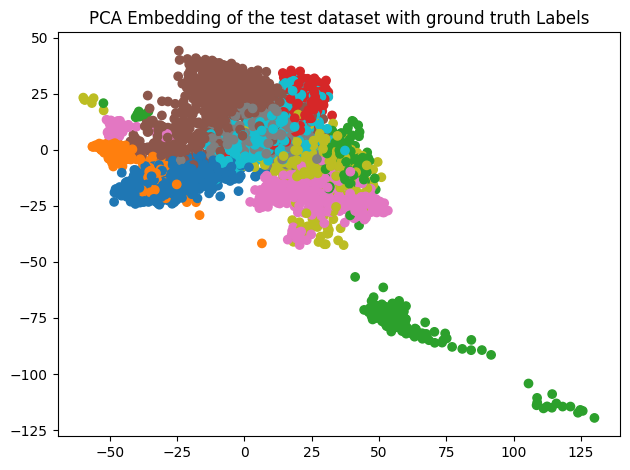

In [87]:
plot_last_layer_embeddings_representation_model_net(model_net, test_loader, num_classes)

The representation of the images can be approximately clustered. However this is not so easy to know to which class belong a sample.

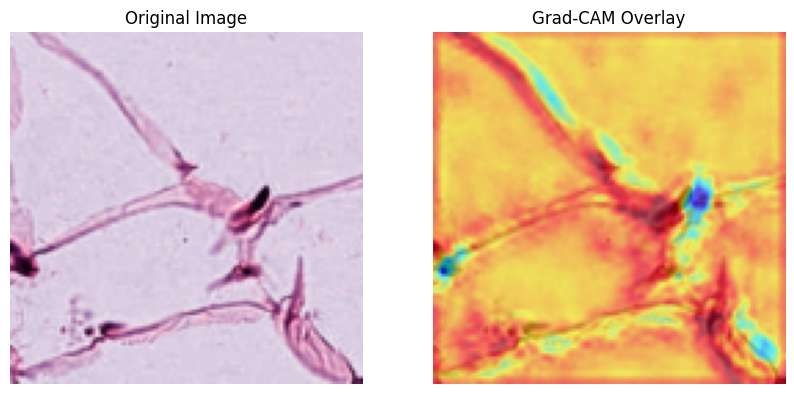

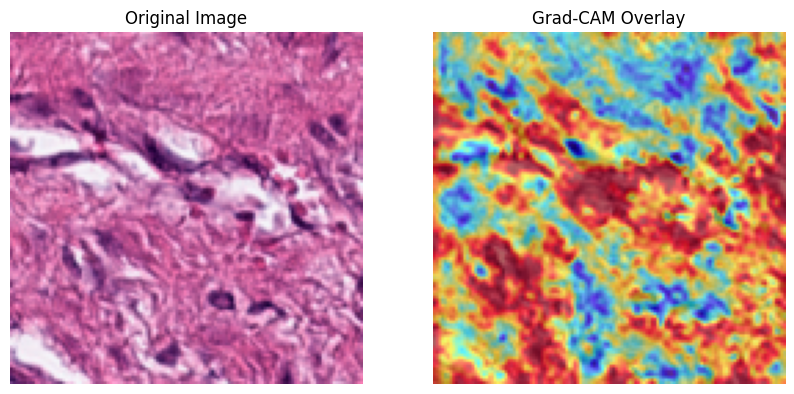

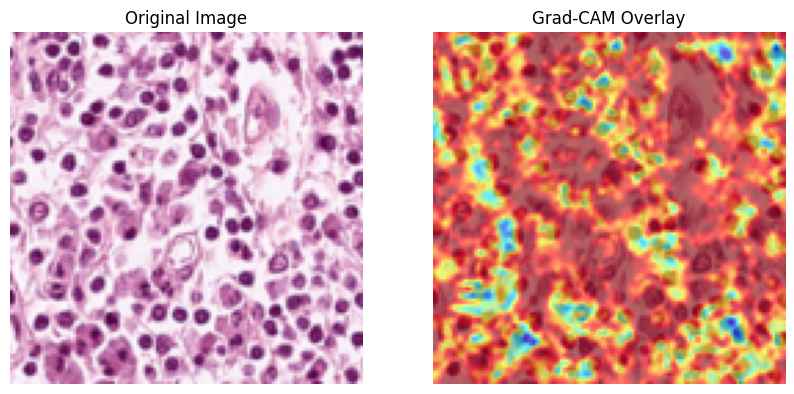

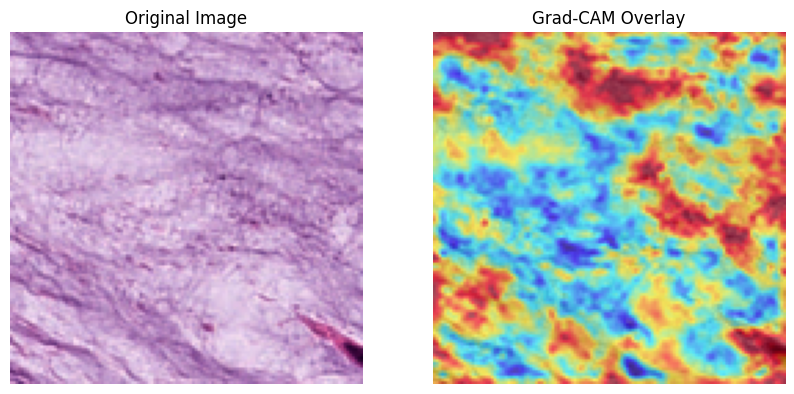

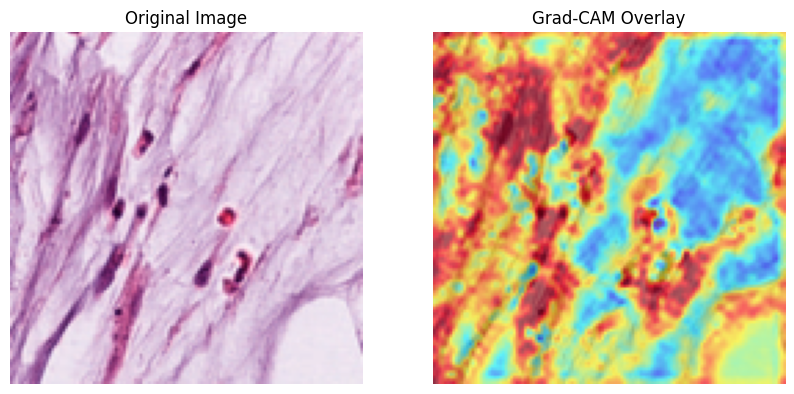

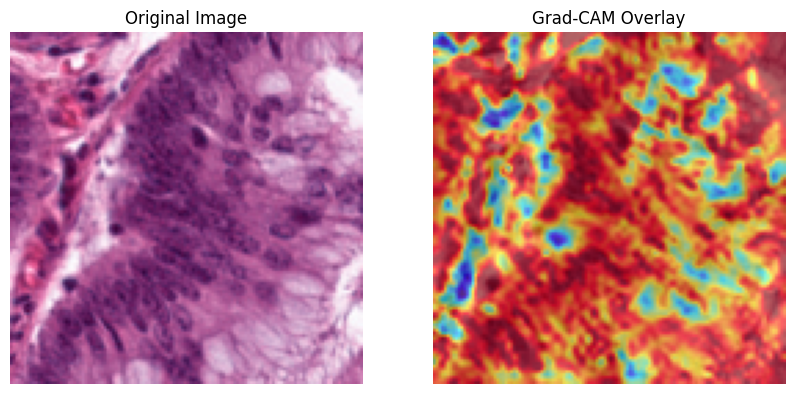

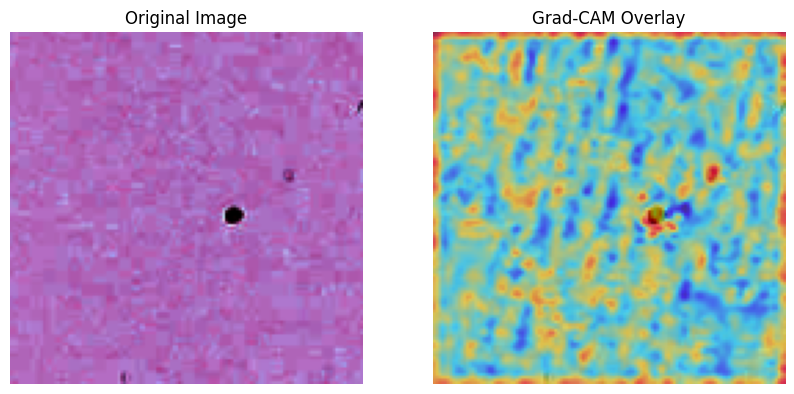

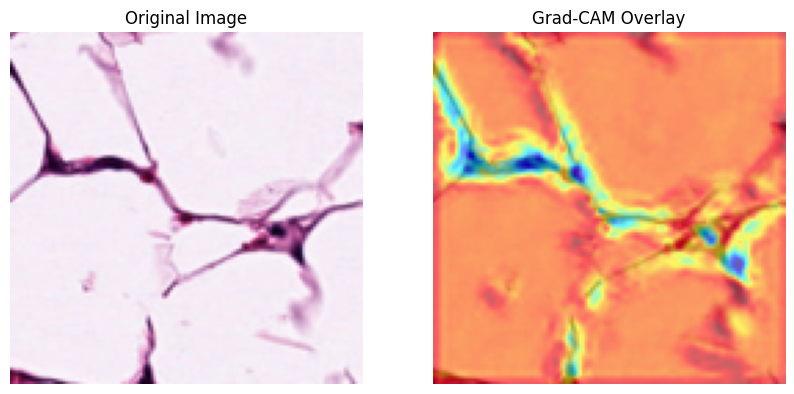

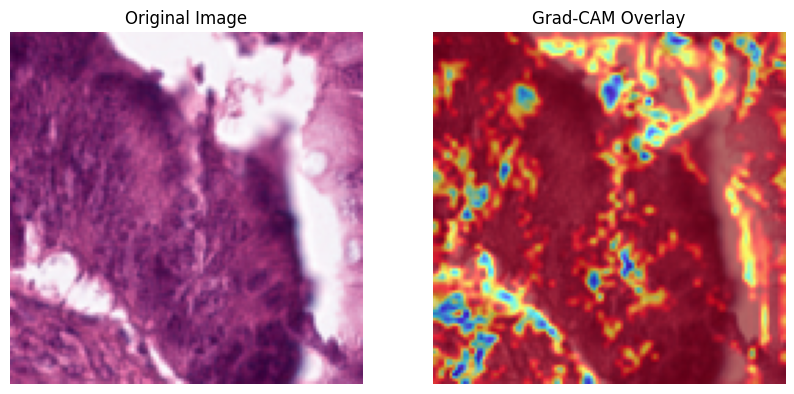

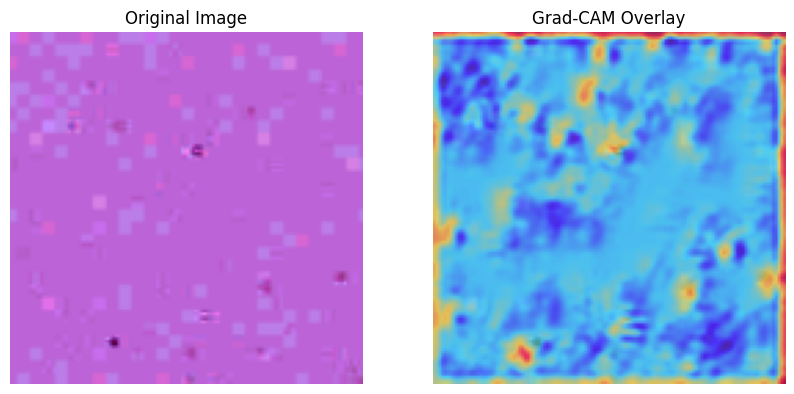

In [88]:
gradients = None
activations = None

model_net.eval()

plot_grad_cam_model_net(model_net, test_loader, image_size = SIZE_IMAGES)

100%|██████████| 88/88 [02:25<00:00,  1.65s/it]


Epoch 1/3, Loss: 0.7916, Accuracy: 76.80%
Epoch 1/3, Val Loss: 0.3346, Val Accuracy: 93.03%


100%|██████████| 88/88 [02:24<00:00,  1.65s/it]


Epoch 2/3, Loss: 0.2135, Accuracy: 93.99%
Epoch 2/3, Val Loss: 0.2142, Val Accuracy: 95.21%


100%|██████████| 88/88 [02:25<00:00,  1.66s/it]


Epoch 3/3, Loss: 0.1521, Accuracy: 95.61%
Epoch 3/3, Val Loss: 0.1693, Val Accuracy: 96.13%


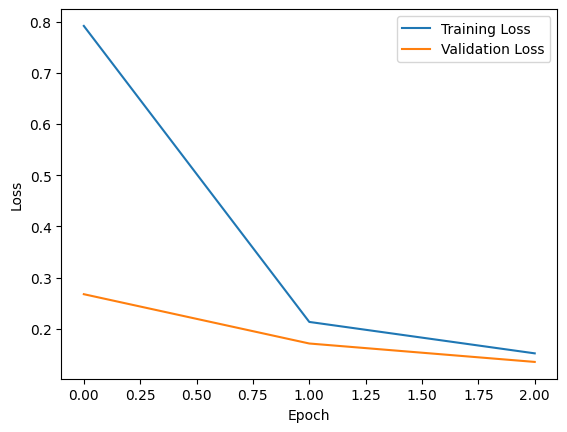

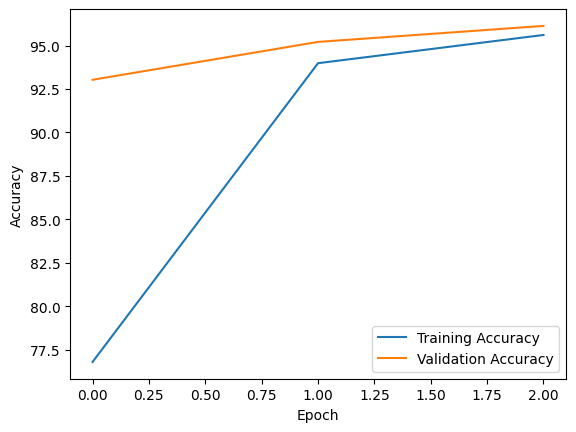

In [90]:
NUM_EPOCHS = 3

resnet18_model = resnet18(pretrained=True).to(device)

num_features = resnet18_model.fc.in_features
resnet18_model.fc = nn.Linear(num_features, num_classes)

trained_resnet18_model = train_model(resnet18_model, train_loader, val_loader, task, NUM_EPOCHS, lr)

In [91]:
y_true,pred = evaluate(trained_resnet18_model, test_loader, task)

correct_images=np.where(y_true.flatten() == pred.flatten())[0]
wrong_images=np.where(~(y_true.flatten() == pred.flatten()))[0]

Test Accuracy: 95.32%


torch.Size([7180, 512])


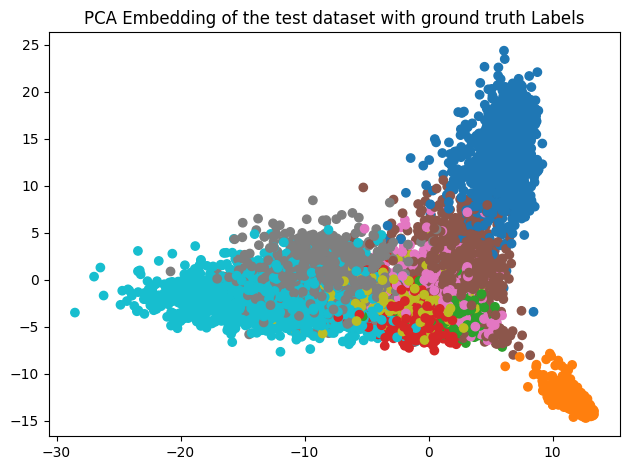

In [92]:
plot_last_layer_embeddings_representation_resnet(trained_resnet18_model, test_loader, num_classes)

This time with resnet, the representations can be less good clustered.

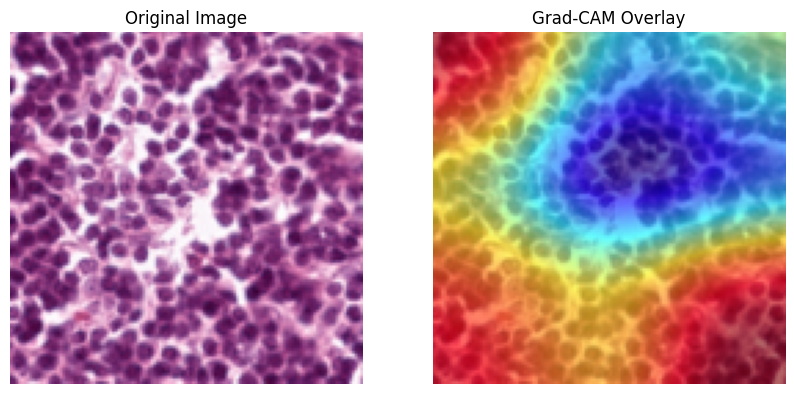

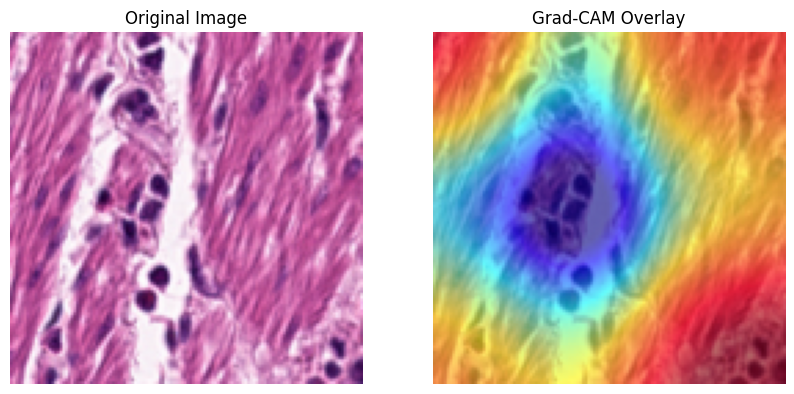

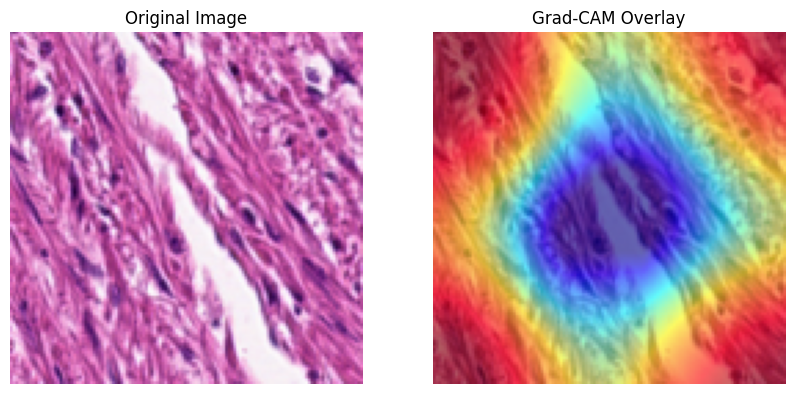

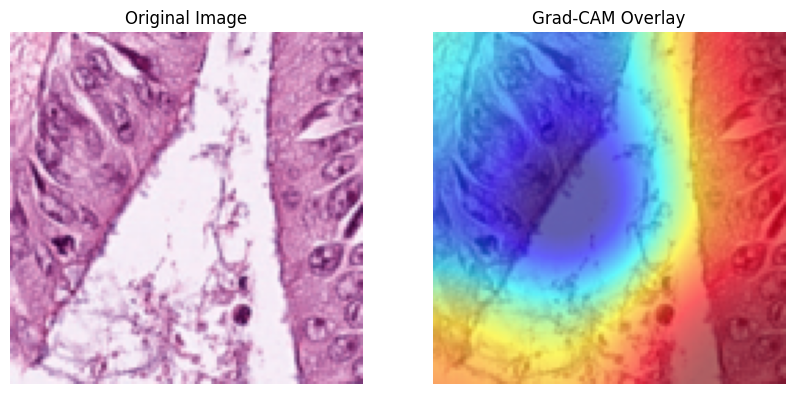

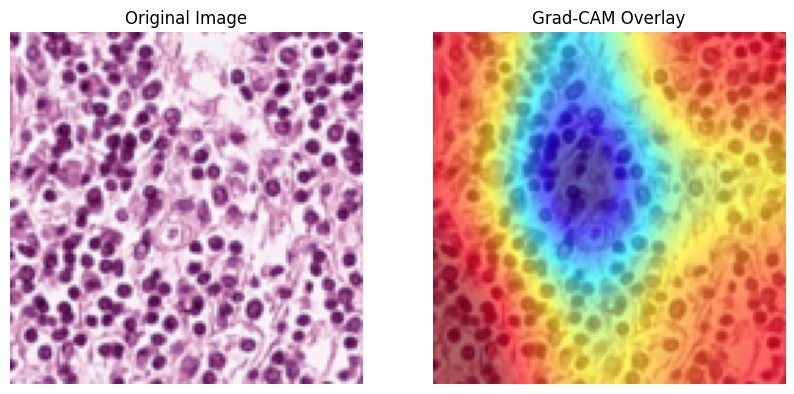

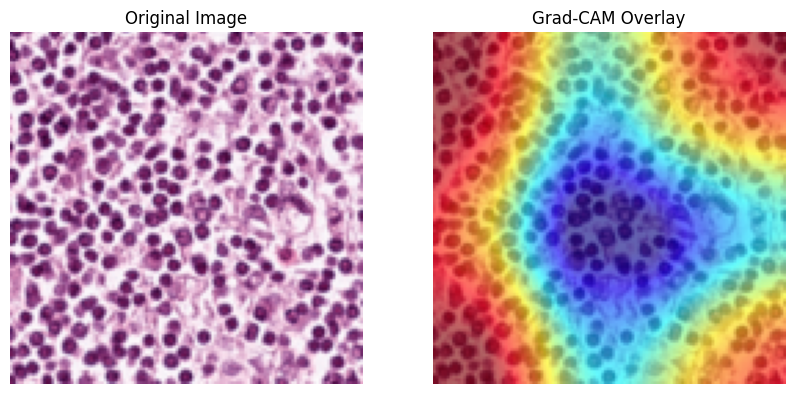

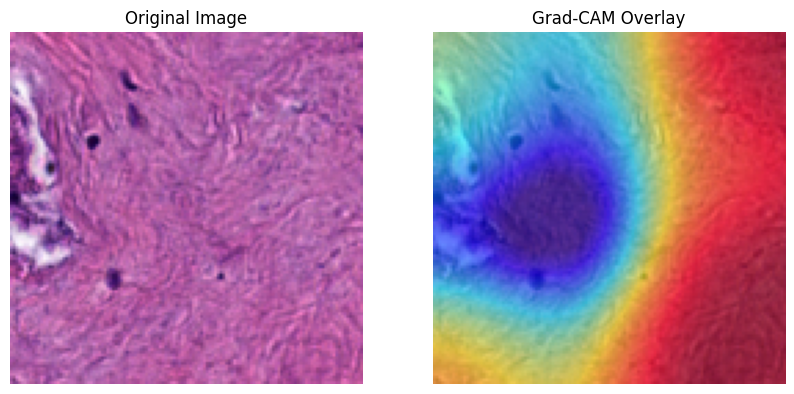

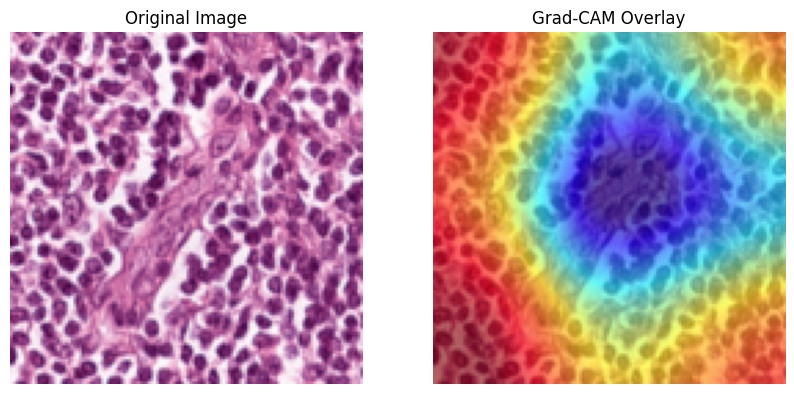

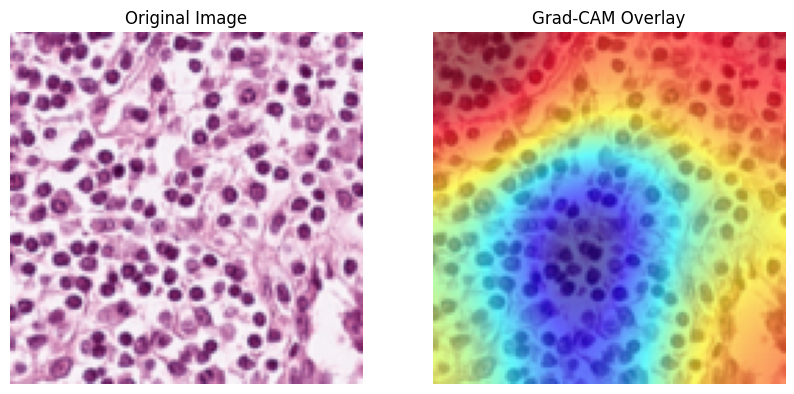

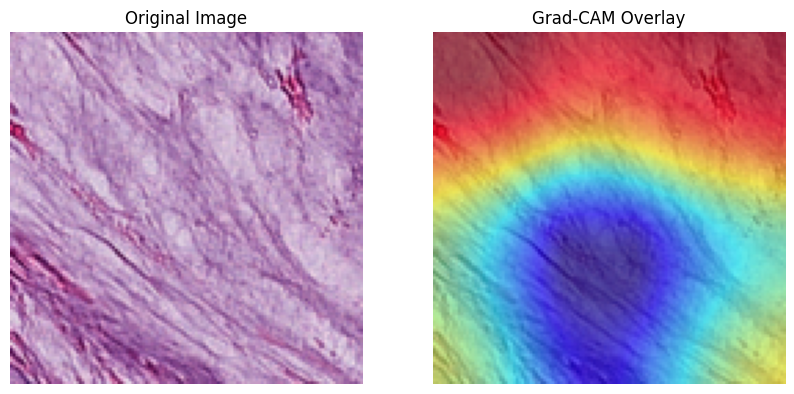

In [104]:
gradients = None
activations = None

trained_resnet18_model.eval()

plot_grad_cam_resnet(trained_resnet18_model, test_loader, image_size = SIZE_IMAGES)

This time, with resnet at his final convolutuional layer it seems that it looks more at relatively big regions while for our model_net, it was more looking at local regions.

#### DermaMNIST dataset

In [105]:
# Dataset Hyper-parameters
dataset_name = "dermamnist"  # Change this to any MedMNIST dataset (e.g., "chestmnist", "bloodmnist")
SIZE_IMAGES = 128 # 28, 64, 128, 256
BATCH_SIZE = 1024

In [106]:
# Run training on any MedMNIST dataset
train_dataset, val_dataset, test_dataset, train_loader, val_loader, test_loader, in_channels, num_classes, task = load_medmnist(dataset_name, BATCH_SIZE, SIZE_IMAGES)

print('The task is', task)
# Get image size from the dataset
image_size = train_loader.dataset.imgs.shape[1]  # Works for all MedMNIST datasets
print('The size of images is ', image_size)

100%|██████████| 373M/373M [07:30<00:00, 826kB/s]


Using downloaded and verified file: /root/.medmnist/dermamnist_128.npz
Using downloaded and verified file: /root/.medmnist/dermamnist_128.npz
The task is multi-class
The size of images is  128


In [107]:
# Initialize model
model_net_2 = Net(in_channels=in_channels, num_classes=num_classes, input_size=SIZE_IMAGES)

In [108]:
# Optimization Hyper-parameters
NUM_EPOCHS = 8
lr = 0.001

100%|██████████| 7/7 [00:14<00:00,  2.05s/it]


Epoch 1/8, Loss: 1.6895, Accuracy: 47.77%
Epoch 1/8, Val Loss: 0.9052, Val Accuracy: 66.90%


100%|██████████| 7/7 [00:13<00:00,  1.86s/it]


Epoch 2/8, Loss: 1.2312, Accuracy: 66.98%
Epoch 2/8, Val Loss: 0.8012, Val Accuracy: 66.90%


100%|██████████| 7/7 [00:13<00:00,  1.90s/it]


Epoch 3/8, Loss: 1.0525, Accuracy: 66.68%
Epoch 3/8, Val Loss: 0.7111, Val Accuracy: 66.90%


100%|██████████| 7/7 [00:12<00:00,  1.85s/it]


Epoch 4/8, Loss: 0.9897, Accuracy: 66.98%
Epoch 4/8, Val Loss: 0.6411, Val Accuracy: 66.90%


100%|██████████| 7/7 [00:13<00:00,  1.88s/it]


Epoch 5/8, Loss: 0.9482, Accuracy: 66.96%
Epoch 5/8, Val Loss: 0.5933, Val Accuracy: 66.90%


100%|██████████| 7/7 [00:13<00:00,  1.89s/it]


Epoch 6/8, Loss: 0.9195, Accuracy: 66.96%
Epoch 6/8, Val Loss: 0.4922, Val Accuracy: 66.90%


100%|██████████| 7/7 [00:13<00:00,  1.87s/it]


Epoch 7/8, Loss: 0.8963, Accuracy: 67.33%
Epoch 7/8, Val Loss: 0.4559, Val Accuracy: 68.39%


100%|██████████| 7/7 [00:13<00:00,  1.90s/it]


Epoch 8/8, Loss: 0.8753, Accuracy: 68.19%
Epoch 8/8, Val Loss: 0.4329, Val Accuracy: 68.59%


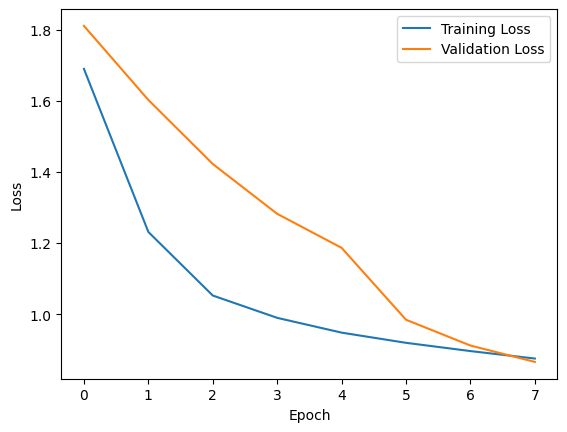

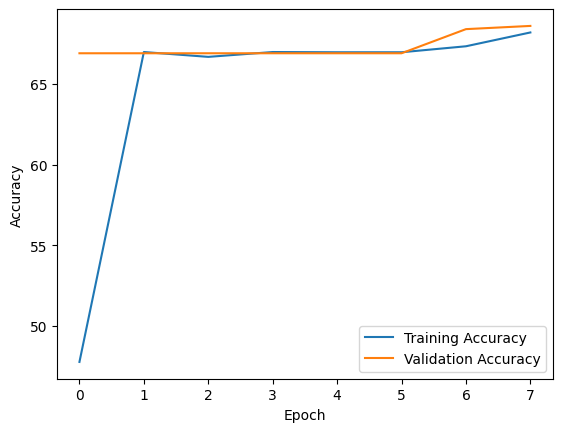

In [109]:
trained_model_net_2 = train_model(model_net_2, train_loader, val_loader, task, NUM_EPOCHS, lr)

In [110]:
y_true,pred = evaluate(trained_model_net_2, test_loader, task)

correct_images=np.where(y_true.flatten() == pred.flatten())[0]
wrong_images=np.where(~(y_true.flatten() == pred.flatten()))[0]

Test Accuracy: 68.73%


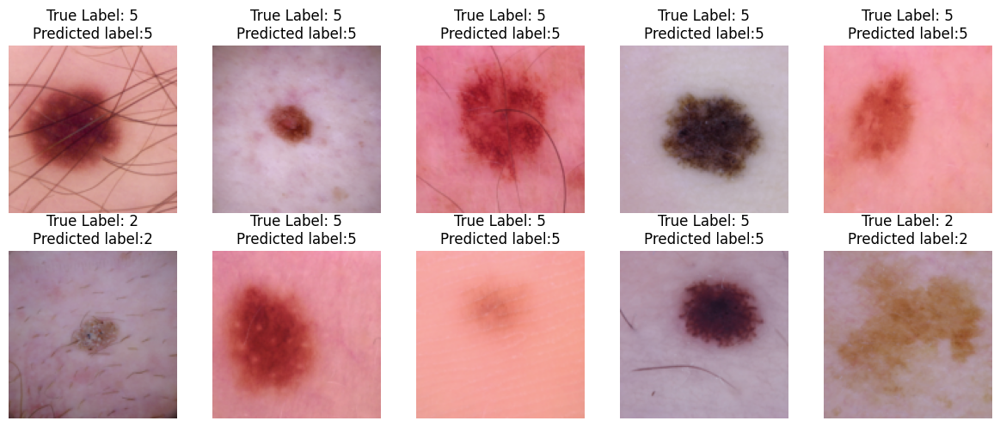

In [111]:
# Correctly classified
fig, axes = plt.subplots(2, 5, figsize=(12, 5))

# Flatten axes for easy iteration
axes = axes.flatten()

selected_indices = correct_images[:10]

# Iterate through the selected indices
for i, idx in enumerate(selected_indices):
    image, label = test_loader.dataset[idx]  # Extract image and label

    # If image is RGB, swap dimensions from (C, H, W) to (H, W, C)
    mean=torch.tensor([.5])
    std=torch.tensor([.5])
    unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())
    img = np.clip(unnormalize(image).numpy(),0,1)
    img = img.transpose(1, 2, 0)  # Convert from PyTorch format to Matplotlib format

    axes[i].imshow(img)  # Adjust cmap if necessary
    axes[i].set_title(f"True Label: {label[0]}\nPredicted label:{pred[idx]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

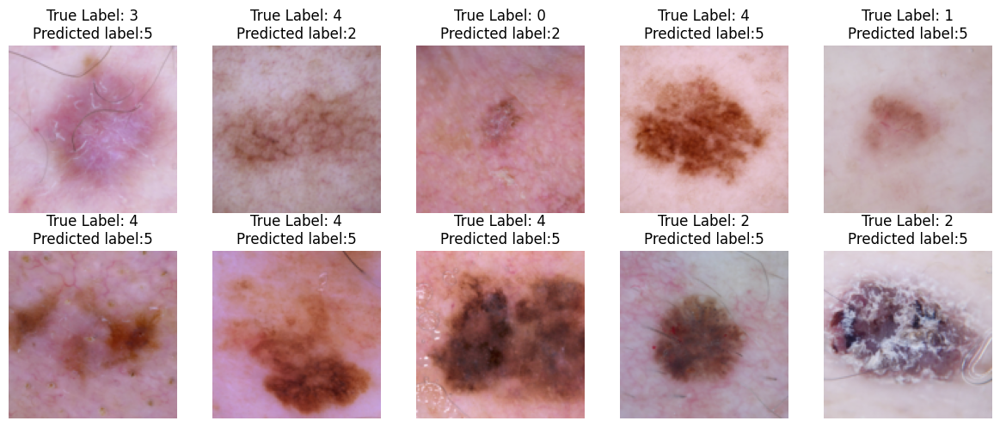

In [112]:
# Wrongly classified
fig, axes = plt.subplots(2, 5, figsize=(12, 5))

# Flatten axes for easy iteration
axes = axes.flatten()

selected_indices = wrong_images[:10]

# Iterate through the selected indices
for i, idx in enumerate(selected_indices):
    image, label = test_loader.dataset[idx]  # Extract image and label

    # If image is RGB, swap dimensions from (C, H, W) to (H, W, C)
    mean=torch.tensor([.5])
    std=torch.tensor([.5])
    unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())
    img = np.clip(unnormalize(image).numpy(),0,1)
    img = img.transpose(1, 2, 0)  # Convert from PyTorch format to Matplotlib format

    axes[i].imshow(img)  # Adjust cmap if necessary
    axes[i].set_title(f"True Label: {label[0]}\nPredicted label:{pred[idx]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

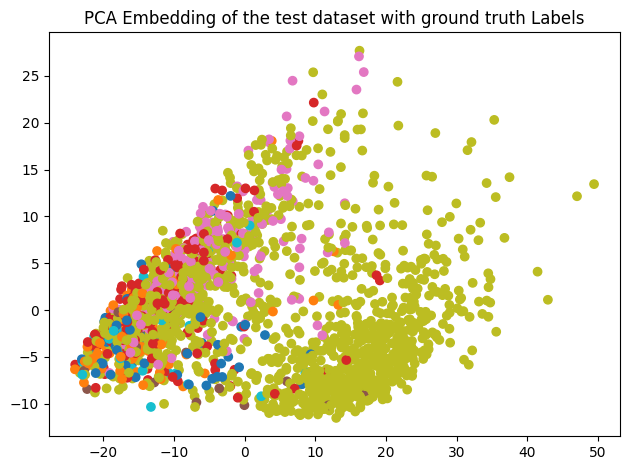

In [113]:
plot_last_layer_embeddings_representation_model_net(trained_model_net_2, test_loader, num_classes)

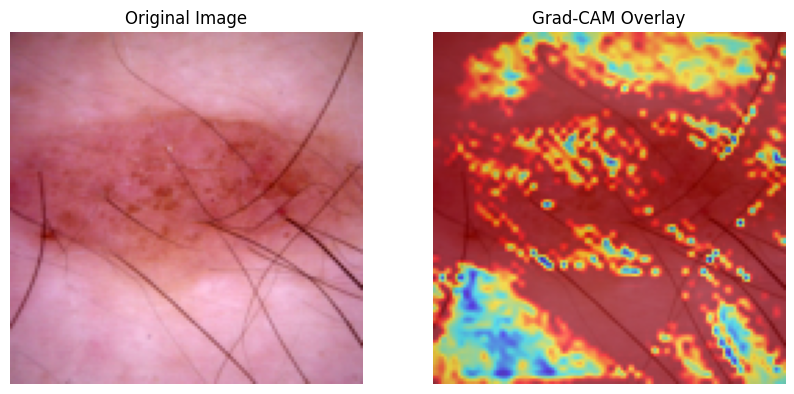

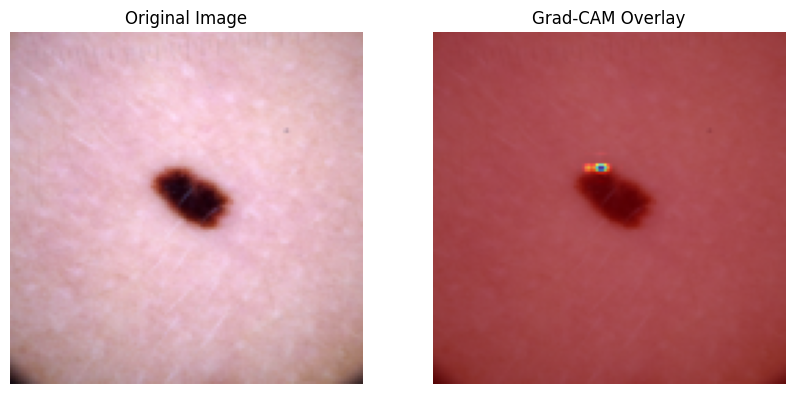

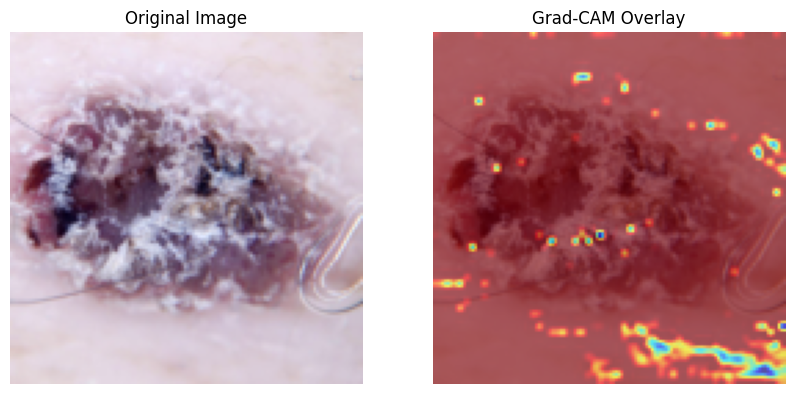

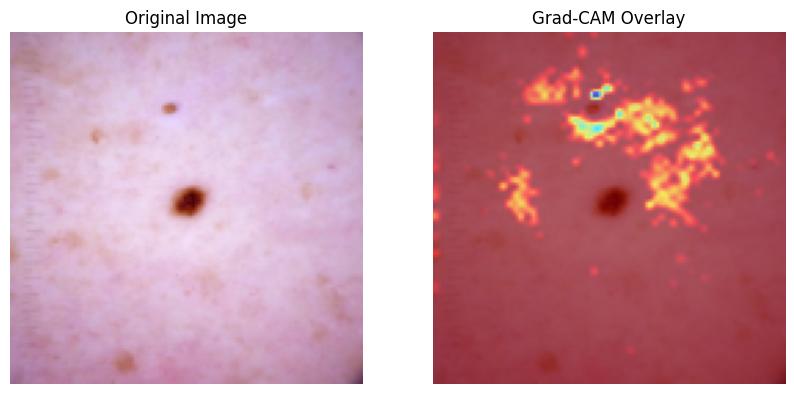

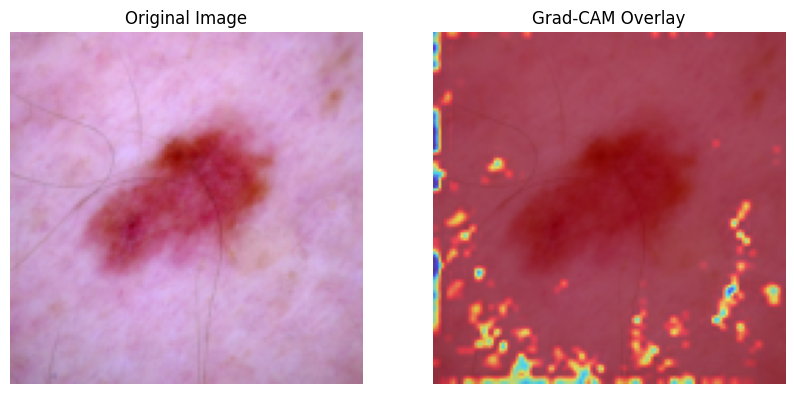

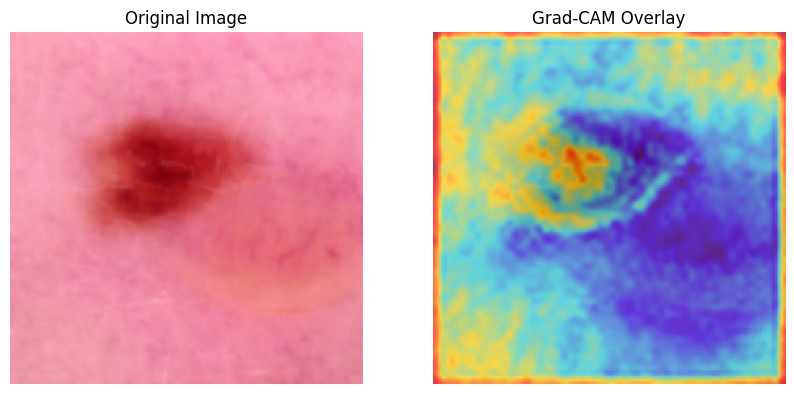

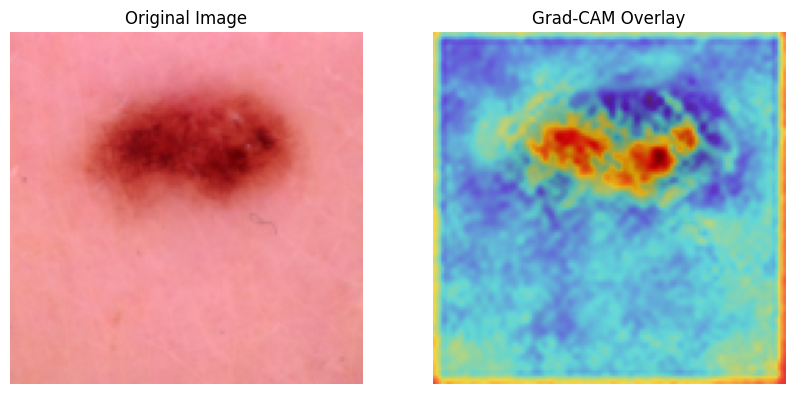

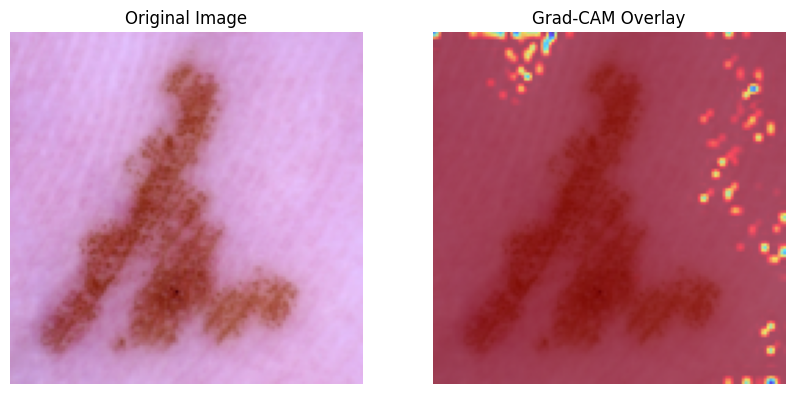

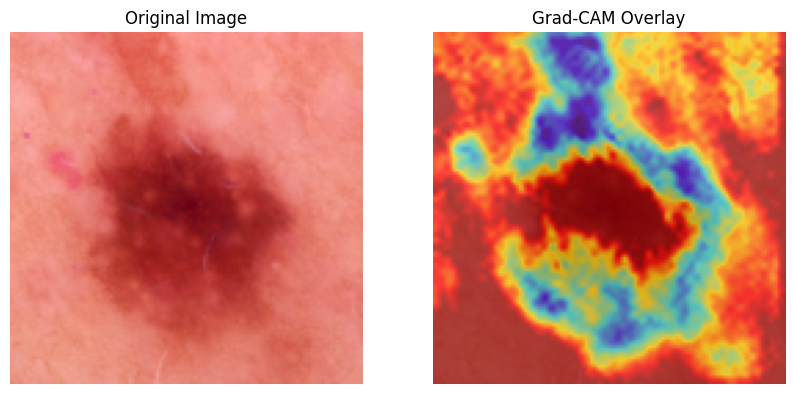

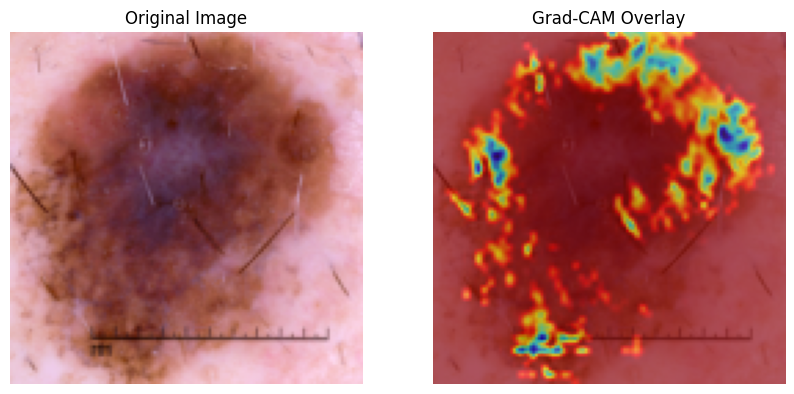

In [114]:
gradients = None
activations = None

trained_model_net_2.eval()

# Call the function to visualize Grad-CAM for PathMNIST dataset
plot_grad_cam_model_net(trained_model_net_2, test_loader, image_size = SIZE_IMAGES)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
100%|██████████| 7/7 [00:10<00:00,  1.47s/it]


Epoch 1/8, Loss: 1.5893, Accuracy: 45.05%
Epoch 1/8, Val Loss: 0.6174, Val Accuracy: 66.90%


100%|██████████| 7/7 [00:10<00:00,  1.49s/it]


Epoch 2/8, Loss: 1.1943, Accuracy: 67.02%
Epoch 2/8, Val Loss: 0.5528, Val Accuracy: 66.80%


100%|██████████| 7/7 [00:10<00:00,  1.50s/it]


Epoch 3/8, Loss: 0.9681, Accuracy: 67.06%
Epoch 3/8, Val Loss: 0.4737, Val Accuracy: 68.89%


100%|██████████| 7/7 [00:10<00:00,  1.52s/it]


Epoch 4/8, Loss: 0.9117, Accuracy: 67.70%
Epoch 4/8, Val Loss: 0.4400, Val Accuracy: 70.39%


100%|██████████| 7/7 [00:10<00:00,  1.51s/it]


Epoch 5/8, Loss: 0.8466, Accuracy: 70.77%
Epoch 5/8, Val Loss: 0.4263, Val Accuracy: 70.39%


100%|██████████| 7/7 [00:10<00:00,  1.53s/it]


Epoch 6/8, Loss: 0.8027, Accuracy: 72.34%
Epoch 6/8, Val Loss: 0.4000, Val Accuracy: 72.38%


100%|██████████| 7/7 [00:10<00:00,  1.50s/it]


Epoch 7/8, Loss: 0.7670, Accuracy: 73.44%
Epoch 7/8, Val Loss: 0.3897, Val Accuracy: 73.48%


100%|██████████| 7/7 [00:10<00:00,  1.52s/it]


Epoch 8/8, Loss: 0.7340, Accuracy: 74.20%
Epoch 8/8, Val Loss: 0.3793, Val Accuracy: 73.98%


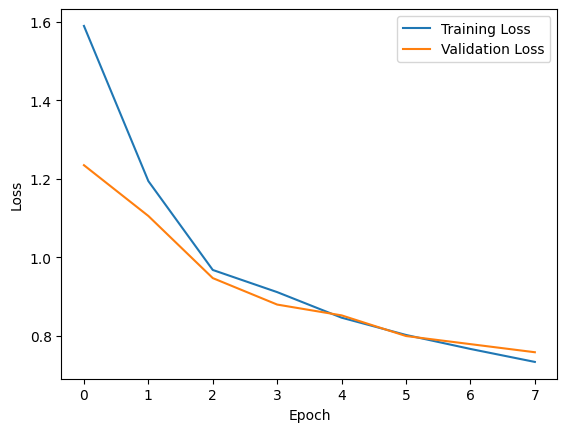

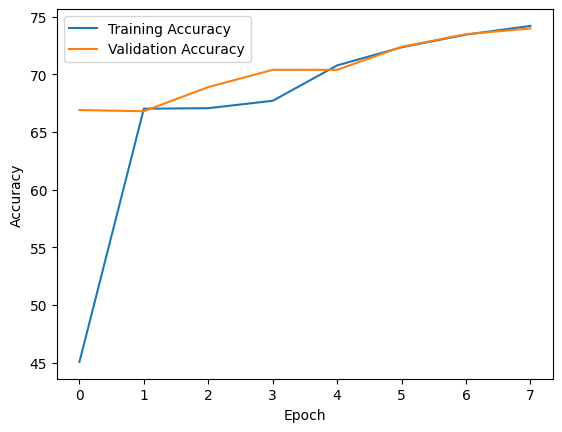

In [115]:
resnet18_model = resnet18(pretrained=True).to(device)

num_features = resnet18_model.fc.in_features
resnet18_model.fc = nn.Linear(num_features, num_classes)

trained_resnet18_model = train_model(resnet18_model, train_loader, val_loader, task, NUM_EPOCHS, lr)

In [116]:
y_true,pred = evaluate(trained_resnet18_model, test_loader, task)

correct_images=np.where(y_true.flatten() == pred.flatten())[0]
wrong_images=np.where(~(y_true.flatten() == pred.flatten()))[0]

Test Accuracy: 73.57%


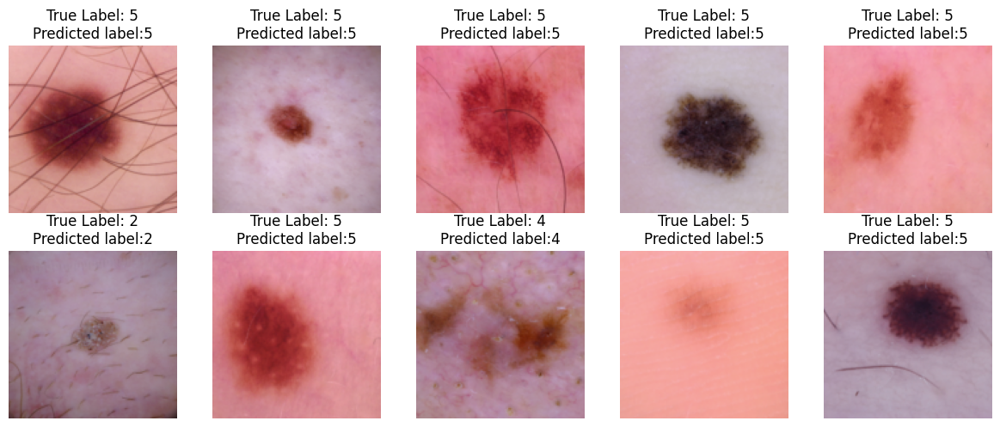

In [117]:
# Correctly classified
fig, axes = plt.subplots(2, 5, figsize=(12, 5))

# Flatten axes for easy iteration
axes = axes.flatten()

selected_indices = correct_images[:10]

# Iterate through the selected indices
for i, idx in enumerate(selected_indices):
    image, label = test_loader.dataset[idx]  # Extract image and label

    # If image is RGB, swap dimensions from (C, H, W) to (H, W, C)
    mean=torch.tensor([.5])
    std=torch.tensor([.5])
    unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())
    img = np.clip(unnormalize(image).numpy(),0,1)
    img = img.transpose(1, 2, 0)  # Convert from PyTorch format to Matplotlib format

    axes[i].imshow(img)  # Adjust cmap if necessary
    axes[i].set_title(f"True Label: {label[0]}\nPredicted label:{pred[idx]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

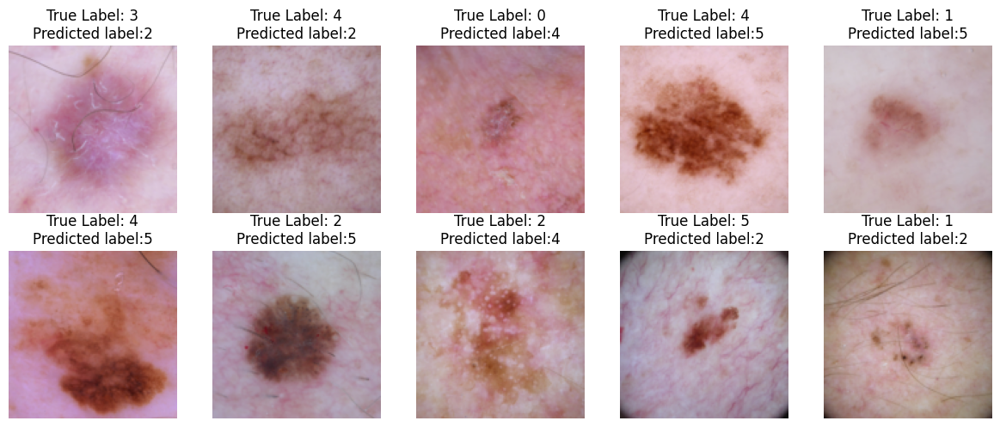

In [118]:
# Wrongly classified
fig, axes = plt.subplots(2, 5, figsize=(12, 5))

# Flatten axes for easy iteration
axes = axes.flatten()

selected_indices = wrong_images[:10]

# Iterate through the selected indices
for i, idx in enumerate(selected_indices):
    image, label = test_loader.dataset[idx]  # Extract image and label

    # If image is RGB, swap dimensions from (C, H, W) to (H, W, C)
    mean=torch.tensor([.5])
    std=torch.tensor([.5])
    unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())
    img = np.clip(unnormalize(image).numpy(),0,1)
    img = img.transpose(1, 2, 0)  # Convert from PyTorch format to Matplotlib format

    axes[i].imshow(img)  # Adjust cmap if necessary
    axes[i].set_title(f"True Label: {label[0]}\nPredicted label:{pred[idx]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

torch.Size([2005, 512])


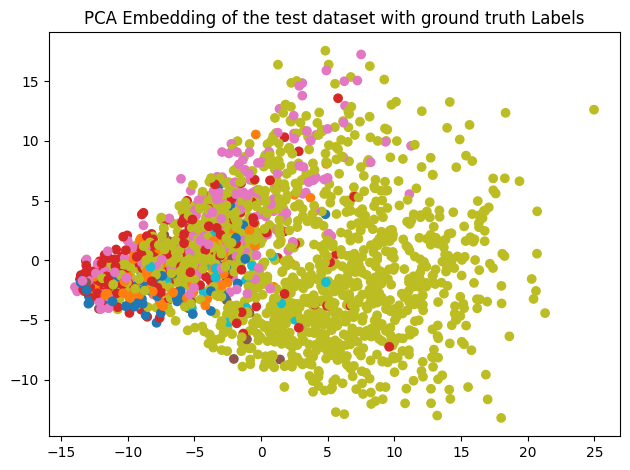

In [119]:
plot_last_layer_embeddings_representation_resnet(trained_resnet18_model, test_loader, num_classes)

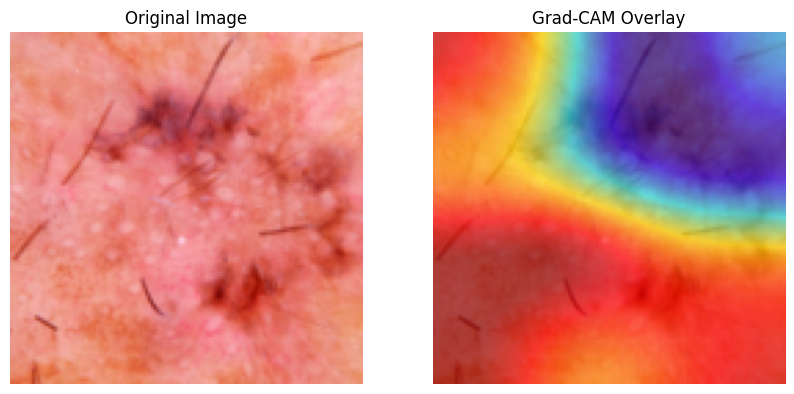

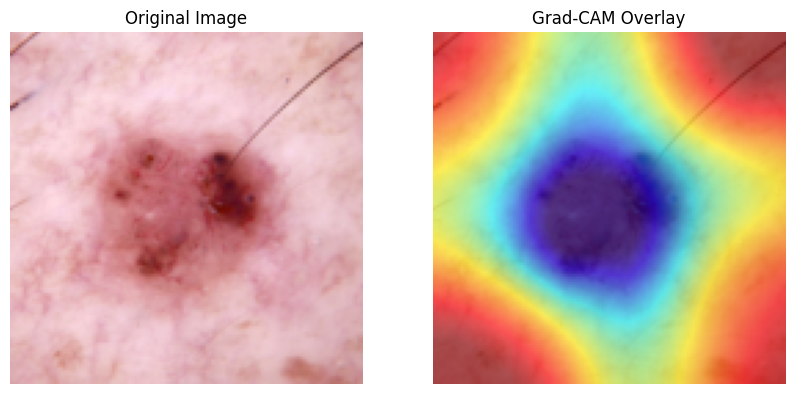

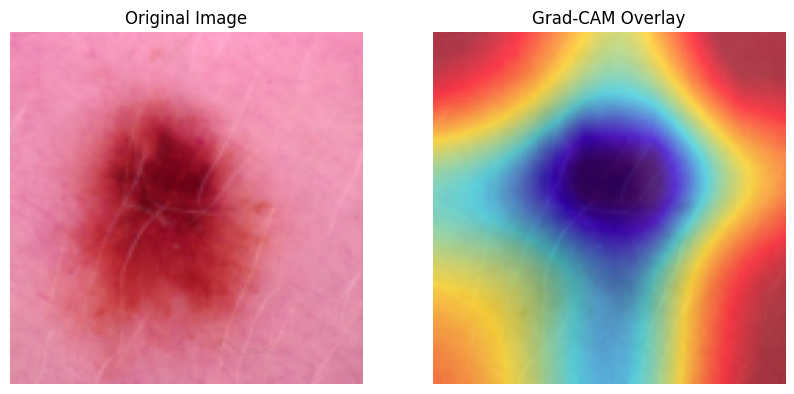

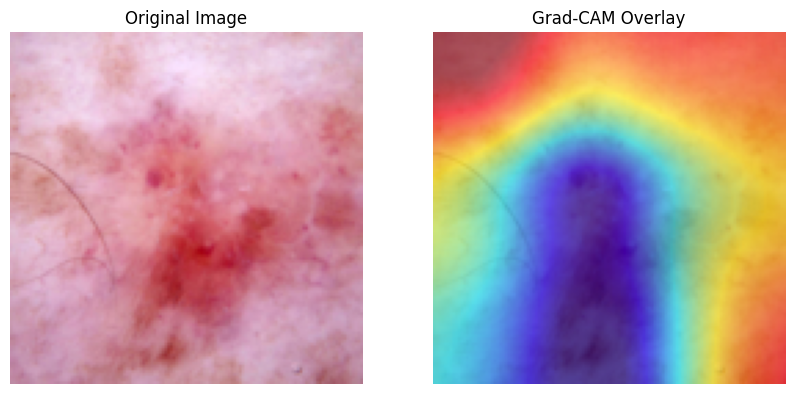

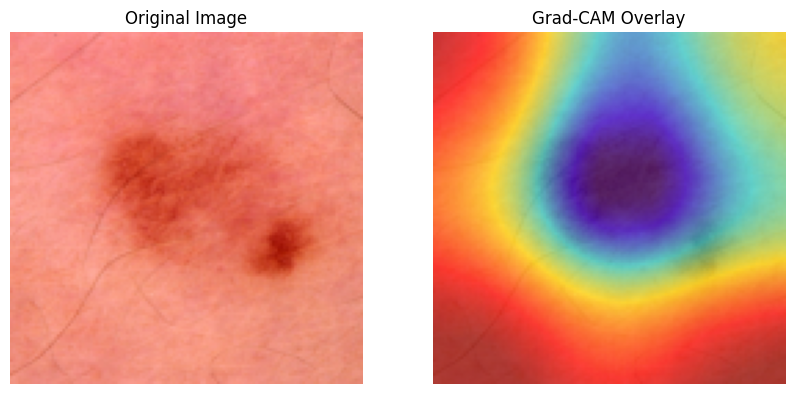

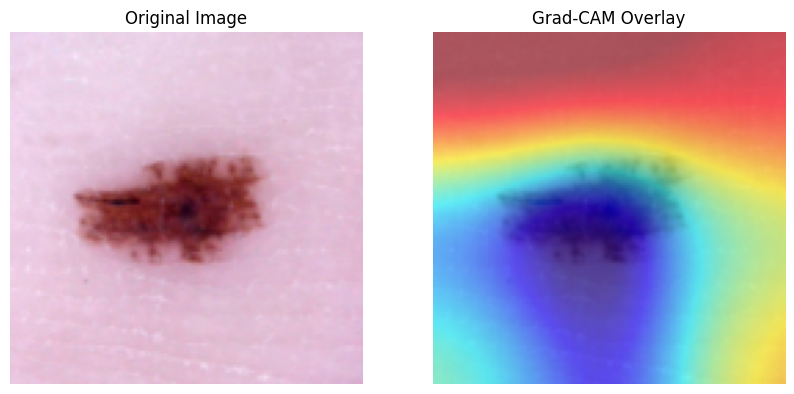

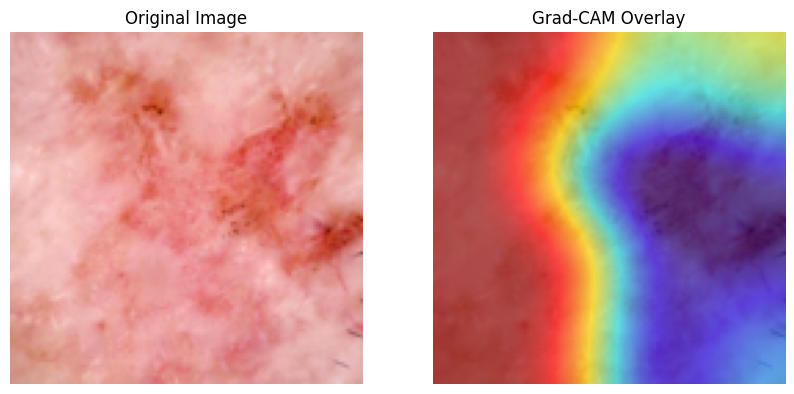

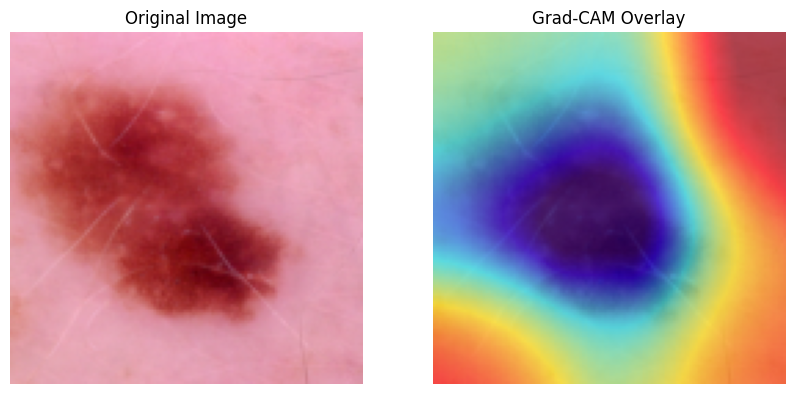

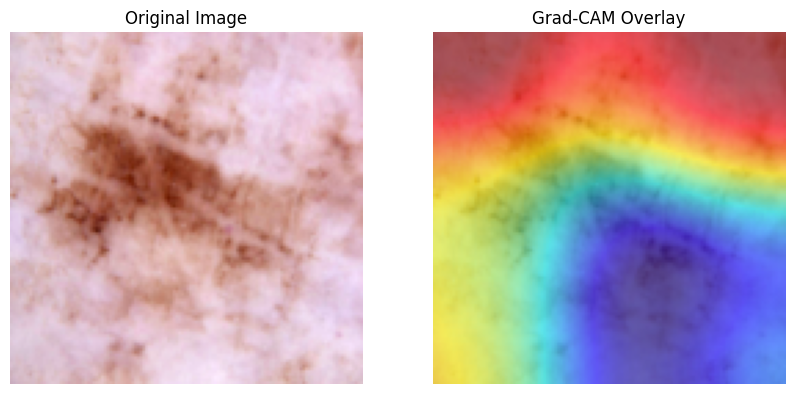

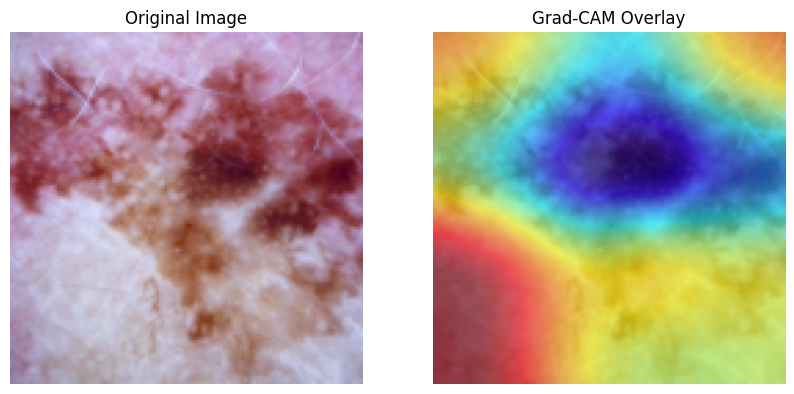

In [120]:
gradients = None
activations = None

trained_resnet18_model.eval()

plot_grad_cam_resnet(trained_resnet18_model, test_loader, image_size = SIZE_IMAGES)